In [1]:
import torch
from torch import nn, optim
from torch.utils.data import DataLoader
from torchvision import datasets
from torchvision import transforms
from torch.utils.data import Dataset
import matplotlib.pyplot as plt
from PIL import Image
import pathlib
import numpy as np
import time

In [2]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Mon Jan 10 08:20:04 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0    27W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
def get_dataloader(image_dir, batch_size):
    train_dataset = AnimeData(image_dir, transform=get_augmentation())
    dataloaders = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

    return dataloaders

def get_fakelebal(image_shape):
    fake_label = torch.zeros(size=image_shape, requires_grad=False)
    return fake_label

In [5]:
class AnimeData(Dataset):

    def __init__(self, image_dir):
        super(AnimeData, self).__init__()

        self.image_dir = image_dir
        self.image_list = self.get_image_list()
        self.means, self.stds = self.get_mean_std()

    def get_image_list(self):
        return list(sorted(pathlib.Path(self.image_dir).glob("*.jpg")))

    def __len__(self):
        return len(self.image_list)

    def __getitem__(self, index):
        image_path = self.image_list[index]
 
        image = Image.open(str(image_path))
        image = self.get_augmentation(image)

        return image

    def get_mean_std(self):
        means = np.zeros((3, 1), dtype=np.float)
        stds = np.zeros((3, 1), dtype=np.float)
        for i in range(len(self.image_list)):
            image_path = self.image_list[i]
            image = transforms.ToTensor()(Image.open(str(image_path)))
            image = image.cpu().numpy()
            for ch in range(3):
                means[ch] += image[ch, :, :].mean()
                stds[ch] += image[ch, :, :].std()

        means = means / len(self.image_list)
        stds = stds / len(self.image_list)

        return means.squeeze(), stds.squeeze()

    def get_augmentation(self, image, image_size=64):
        train_transform = [
            transforms.Resize((image_size, image_size)),
            transforms.ToTensor(),
            transforms.Normalize(mean=self.means,
                      std=self.stds)
        ]
        aug = transforms.Compose(train_transform)
        image = aug(image)
        return image

In [6]:
class Generator(nn.Module):

    def __init__(self, channel_in, channel_out):
        super(Generator, self).__init__()

        self.channel_in = channel_in
        self.channel_out = channel_out
        net = []

        ch_in = [self.channel_in, 512, 256, 128, 64]
        ch_out = [512, 256, 128, 64, self.channel_out]
        activator = ["R", "R", "R", "R", "tanh"]
        stride = [1, 2, 2, 2, 2]
        padding = [0, 1, 1, 1, 1]

        for i in range(len(ch_in)):
            net.append(nn.ConvTranspose2d(ch_in[i], ch_out[i], kernel_size=4
                                          , stride=stride[i], padding=padding[i]))
            if activator[i] == "R":
                net.append(nn.BatchNorm2d(ch_out[i]))
                net.append(nn.ReLU())
            elif activator[i] == "tanh":
                net.append(nn.Tanh())

        self.generator = nn.Sequential(*net)
        self.weight_init()

    def weight_init(self):
        for m in self.generator.modules():
            if isinstance(m, nn.ConvTranspose2d):
                nn.init.normal_(m.weight.data, 0, 0.02)
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.normal_(m.weight.data, 0, 0.02)
                nn.init.constant_(m.bias.data, 0)

    def forward(self, x):
        out = self.generator(x)
        return out

class Disciminator(nn.Module):

    def __init__(self, channel_in):
        super(Disciminator, self).__init__()

        net = []

        ch_in = [channel_in, 64, 128, 256, 512]
        ch_out = [64, 128, 256, 512, 1]
        activator = ["LR", "LR", "LR", "LR", "sigmoid"]
        stride = 2
        padding = [1, 1, 1, 1, 0]

        for i in range(len(ch_in)):
            net.append(nn.Conv2d(ch_in[i], ch_out[i], stride=stride
                                 , kernel_size=4, padding=padding[i]))

            if activator[i] == "LR":
                net.append(nn.BatchNorm2d(ch_out[i]))
                net.append(nn.LeakyReLU(negative_slope=0.2))
            elif activator[i] == "sigmoid":
                net.append(nn.Sigmoid())

        self.discriminator = nn.Sequential(*net)
        self.weigh_init()

    def weigh_init(self):
        for m in self.discriminator.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.normal_(m.weight.data, 0, 0.02)
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.normal_(m.weight.data, 0, 0.02)
                nn.init.constant_(m.bias.data, 0)

    def forward(self, x):
        out = self.discriminator(x)
        out = out.view(x.size(0), -1)
        return out

In [7]:
import shutil
# image_dir = "/content/drive/Shareddrives/MachineLearning/Colab_Notebooks/DLearning/DCGAN/faces"
image_dir = "/content/drive/Shareddrives/MachineLearning/Colab_Notebooks/DLearning/SRGAN/Train_data"
shutil.copytree(image_dir, 'faces')

In [11]:
"""
Model Setup
"""
batchsize = 64
epochs = 500
ch_in = 3
ch_out = 3
model_dir = "/content/drive/Shareddrives/MachineLearning/Colab_Notebooks/DLearning/DCGAN/GAN_model/"
image_dir = "/content/faces/"
file_name = "_E%d_B%d_CelebA.pth"%(epochs, batchsize)
device = torch.device('cuda')

trainData = AnimeData(image_dir)
train_mean = trainData.means
train_std = trainData.stds
real_image = DataLoader(trainData, batch_size=batchsize, shuffle=True, drop_last=True)

Gmodel = Generator(ch_in, ch_out).to(device)
Dmodel = Disciminator(ch_out).to(device)

Goptim = torch.optim.Adam(Gmodel.parameters(), lr=0.0002, betas=(0.5, 0.999))
Doptim = torch.optim.Adam(Dmodel.parameters(), lr=0.0002, betas=(0.5, 0.999))

criterion = nn.BCELoss()


In [ ]:
# load model
Gmodel = torch.load(model_dir+"G"+"_E500_B64.pth")
Dmodel = torch.load(model_dir+"D"+"_E500_B64.pth")
# Gmodel = torch.load(model_dir+"G"+file_name)
# Dmodel = torch.load(model_dir+"D"+file_name)

----------
Epoch 1/500
----------
Train Loss: 
G Loss : 0.6865
D Loss : 0.9937
Model saved!


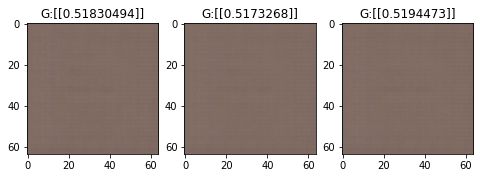

----------
Epoch 2/500
----------
Train Loss: 
G Loss : 0.6912
D Loss : 1.0074
----------
Epoch 3/500
----------
Train Loss: 
G Loss : 0.6366
D Loss : 1.1175
Model saved!


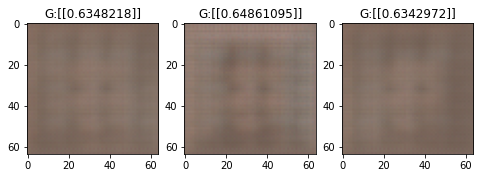

----------
Epoch 4/500
----------
Train Loss: 
G Loss : 0.6083
D Loss : 1.1877
----------
Epoch 5/500
----------
Train Loss: 
G Loss : 0.5967
D Loss : 1.2185
Model saved!


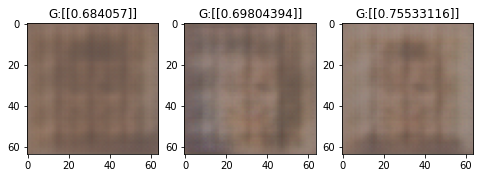

----------
Epoch 6/500
----------
Train Loss: 
G Loss : 0.5942
D Loss : 1.2190
----------
Epoch 7/500
----------
Train Loss: 
G Loss : 0.5784
D Loss : 1.2644
Model saved!


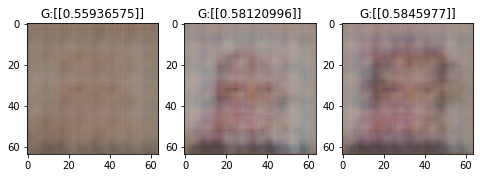

----------
Epoch 8/500
----------
Train Loss: 
G Loss : 0.5765
D Loss : 1.2635
----------
Epoch 9/500
----------
Train Loss: 
G Loss : 0.5797
D Loss : 1.2656
Model saved!


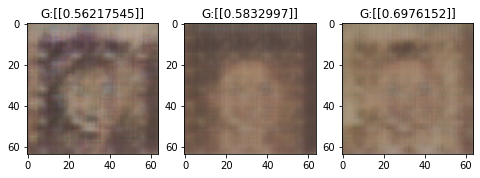

----------
Epoch 10/500
----------
Train Loss: 
G Loss : 0.5762
D Loss : 1.2586
----------
Epoch 11/500
----------
Train Loss: 
G Loss : 0.5759
D Loss : 1.2570
Model saved!


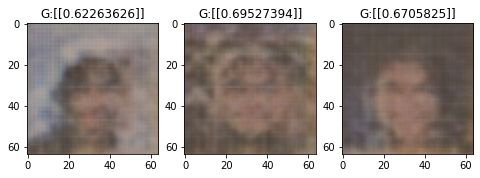

----------
Epoch 12/500
----------
Train Loss: 
G Loss : 0.5962
D Loss : 1.2197
----------
Epoch 13/500
----------
Train Loss: 
G Loss : 0.5843
D Loss : 1.2425
Model saved!


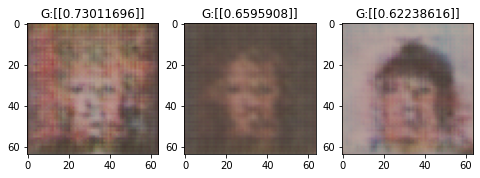

----------
Epoch 14/500
----------
Train Loss: 
G Loss : 0.5835
D Loss : 1.2416
----------
Epoch 15/500
----------
Train Loss: 
G Loss : 0.5948
D Loss : 1.2227
Model saved!


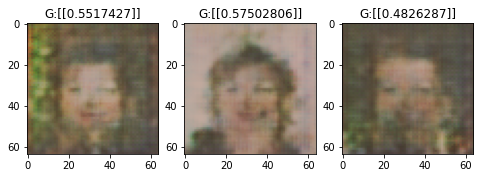

----------
Epoch 16/500
----------
Train Loss: 
G Loss : 0.5942
D Loss : 1.2176
----------
Epoch 17/500
----------
Train Loss: 
G Loss : 0.5910
D Loss : 1.2401
Model saved!


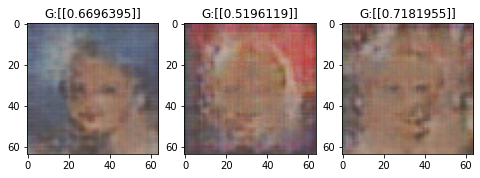

----------
Epoch 18/500
----------
Train Loss: 
G Loss : 0.6066
D Loss : 1.2053
----------
Epoch 19/500
----------
Train Loss: 
G Loss : 0.6062
D Loss : 1.1827
Model saved!


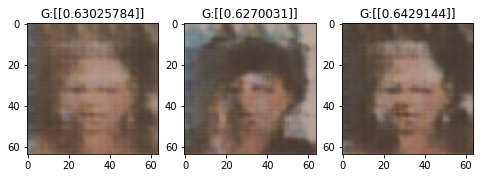

----------
Epoch 20/500
----------
Train Loss: 
G Loss : 0.6086
D Loss : 1.1919
----------
Epoch 21/500
----------
Train Loss: 
G Loss : 0.6070
D Loss : 1.1900
Model saved!


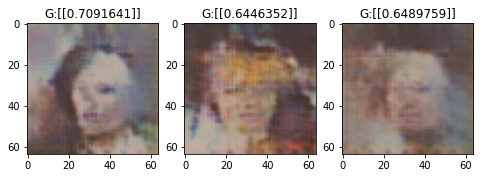

----------
Epoch 22/500
----------
Train Loss: 
G Loss : 0.6064
D Loss : 1.1995
----------
Epoch 23/500
----------
Train Loss: 
G Loss : 0.6010
D Loss : 1.2051
Model saved!


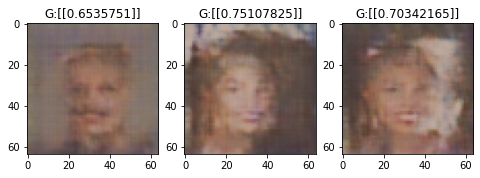

----------
Epoch 24/500
----------
Train Loss: 
G Loss : 0.6058
D Loss : 1.1974
----------
Epoch 25/500
----------
Train Loss: 
G Loss : 0.6112
D Loss : 1.1950
Model saved!


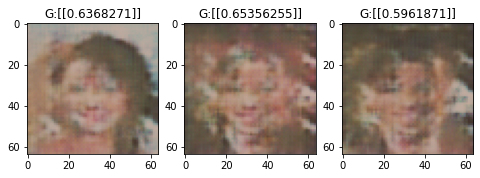

----------
Epoch 26/500
----------
Train Loss: 
G Loss : 0.6032
D Loss : 1.1923
----------
Epoch 27/500
----------
Train Loss: 
G Loss : 0.6119
D Loss : 1.1848
Model saved!


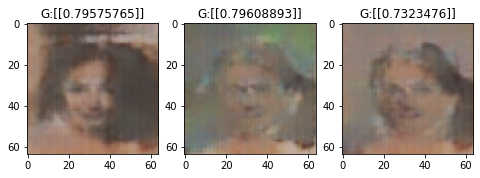

----------
Epoch 28/500
----------
Train Loss: 
G Loss : 0.6041
D Loss : 1.2050
----------
Epoch 29/500
----------
Train Loss: 
G Loss : 0.5996
D Loss : 1.2150
Model saved!


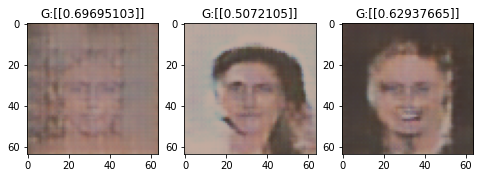

----------
Epoch 30/500
----------
Train Loss: 
G Loss : 0.5997
D Loss : 1.2082
----------
Epoch 31/500
----------
Train Loss: 
G Loss : 0.6097
D Loss : 1.1893
Model saved!


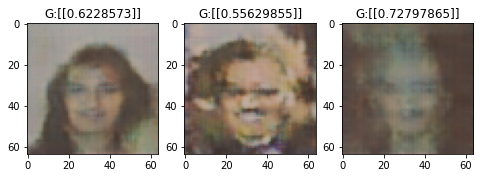

----------
Epoch 32/500
----------
Train Loss: 
G Loss : 0.6165
D Loss : 1.1744
----------
Epoch 33/500
----------
Train Loss: 
G Loss : 0.6119
D Loss : 1.1725
Model saved!


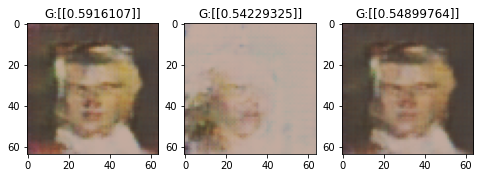

----------
Epoch 34/500
----------
Train Loss: 
G Loss : 0.6224
D Loss : 1.1707
----------
Epoch 35/500
----------
Train Loss: 
G Loss : 0.6151
D Loss : 1.1823
Model saved!


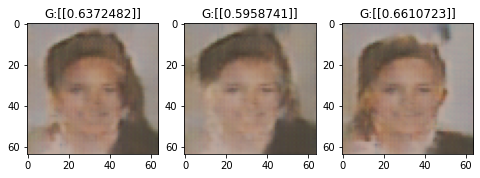

----------
Epoch 36/500
----------
Train Loss: 
G Loss : 0.6225
D Loss : 1.1547
----------
Epoch 37/500
----------
Train Loss: 
G Loss : 0.6271
D Loss : 1.1529
Model saved!


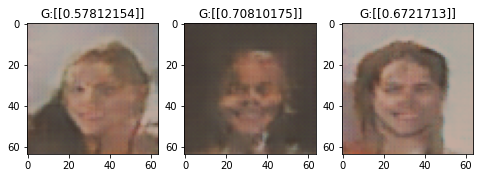

----------
Epoch 38/500
----------
Train Loss: 
G Loss : 0.6238
D Loss : 1.1463
----------
Epoch 39/500
----------
Train Loss: 
G Loss : 0.6259
D Loss : 1.1588
Model saved!


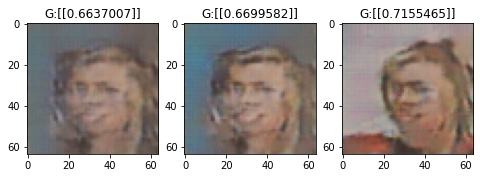

----------
Epoch 40/500
----------
Train Loss: 
G Loss : 0.6246
D Loss : 1.1659
----------
Epoch 41/500
----------
Train Loss: 
G Loss : 0.6387
D Loss : 1.1189
Model saved!


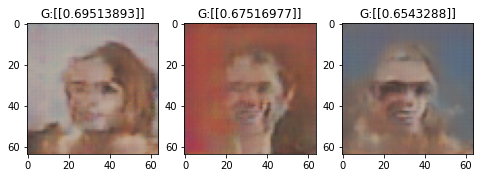

----------
Epoch 42/500
----------
Train Loss: 
G Loss : 0.6269
D Loss : 1.1470
----------
Epoch 43/500
----------
Train Loss: 
G Loss : 0.6267
D Loss : 1.1391
Model saved!


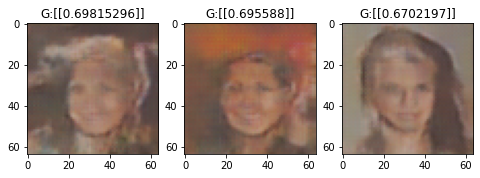

----------
Epoch 44/500
----------
Train Loss: 
G Loss : 0.6311
D Loss : 1.1374
----------
Epoch 45/500
----------
Train Loss: 
G Loss : 0.6277
D Loss : 1.1483
Model saved!


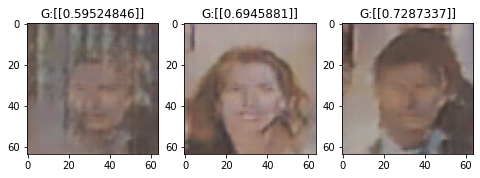

----------
Epoch 46/500
----------
Train Loss: 
G Loss : 0.6311
D Loss : 1.1500
----------
Epoch 47/500
----------
Train Loss: 
G Loss : 0.6261
D Loss : 1.1350
Model saved!


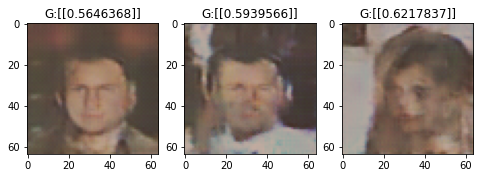

----------
Epoch 48/500
----------
Train Loss: 
G Loss : 0.6347
D Loss : 1.1500
----------
Epoch 49/500
----------
Train Loss: 
G Loss : 0.6290
D Loss : 1.1425
Model saved!


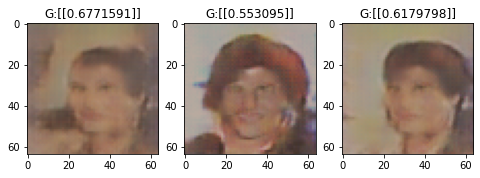

----------
Epoch 50/500
----------
Train Loss: 
G Loss : 0.6260
D Loss : 1.1405
----------
Epoch 51/500
----------
Train Loss: 
G Loss : 0.6317
D Loss : 1.1459
Model saved!


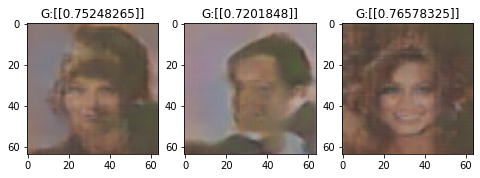

----------
Epoch 52/500
----------
Train Loss: 
G Loss : 0.6347
D Loss : 1.1382
----------
Epoch 53/500
----------
Train Loss: 
G Loss : 0.6340
D Loss : 1.1235
Model saved!


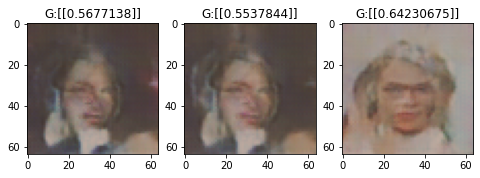

----------
Epoch 54/500
----------
Train Loss: 
G Loss : 0.6320
D Loss : 1.1362
----------
Epoch 55/500
----------
Train Loss: 
G Loss : 0.6359
D Loss : 1.1307
Model saved!


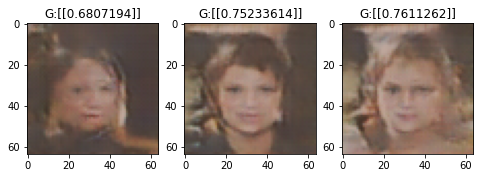

----------
Epoch 56/500
----------
Train Loss: 
G Loss : 0.6366
D Loss : 1.1327
----------
Epoch 57/500
----------
Train Loss: 
G Loss : 0.6395
D Loss : 1.1145
Model saved!


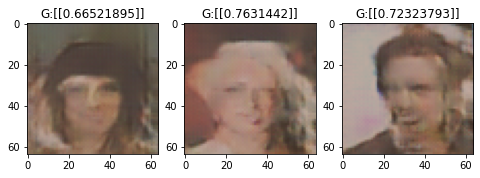

----------
Epoch 58/500
----------
Train Loss: 
G Loss : 0.6356
D Loss : 1.1315
----------
Epoch 59/500
----------
Train Loss: 
G Loss : 0.6418
D Loss : 1.1180
Model saved!


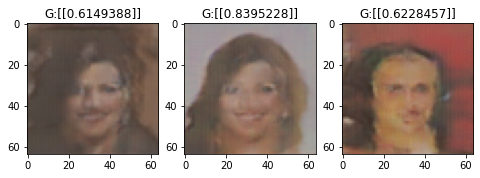

----------
Epoch 60/500
----------
Train Loss: 
G Loss : 0.6366
D Loss : 1.1168
----------
Epoch 61/500
----------
Train Loss: 
G Loss : 0.6405
D Loss : 1.1100
Model saved!


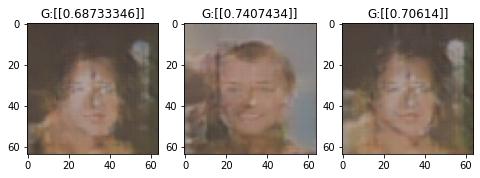

----------
Epoch 62/500
----------
Train Loss: 
G Loss : 0.6443
D Loss : 1.1163
----------
Epoch 63/500
----------
Train Loss: 
G Loss : 0.6397
D Loss : 1.1267
Model saved!


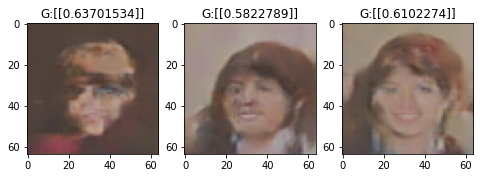

----------
Epoch 64/500
----------
Train Loss: 
G Loss : 0.6428
D Loss : 1.1152
----------
Epoch 65/500
----------
Train Loss: 
G Loss : 0.6433
D Loss : 1.1047
Model saved!


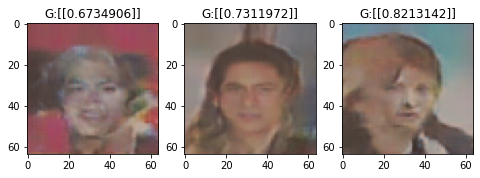

----------
Epoch 66/500
----------
Train Loss: 
G Loss : 0.6440
D Loss : 1.1089
----------
Epoch 67/500
----------
Train Loss: 
G Loss : 0.6476
D Loss : 1.1067
Model saved!


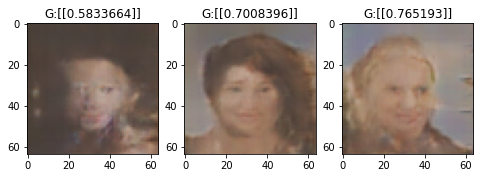

----------
Epoch 68/500
----------
Train Loss: 
G Loss : 0.6476
D Loss : 1.1018
----------
Epoch 69/500
----------
Train Loss: 
G Loss : 0.6459
D Loss : 1.1069
Model saved!


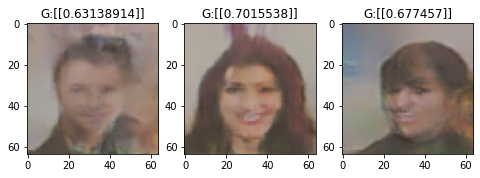

----------
Epoch 70/500
----------
Train Loss: 
G Loss : 0.6513
D Loss : 1.0999
----------
Epoch 71/500
----------
Train Loss: 
G Loss : 0.6472
D Loss : 1.0969
Model saved!


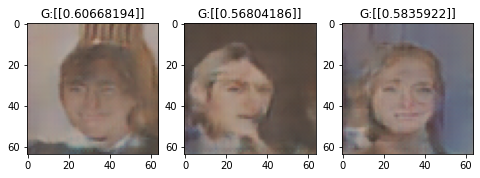

----------
Epoch 72/500
----------
Train Loss: 
G Loss : 0.6554
D Loss : 1.0840
----------
Epoch 73/500
----------
Train Loss: 
G Loss : 0.6535
D Loss : 1.0893
Model saved!


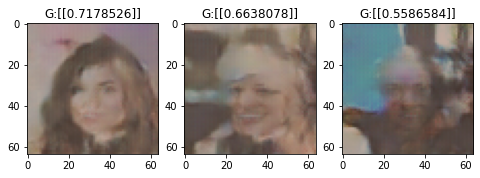

----------
Epoch 74/500
----------
Train Loss: 
G Loss : 0.6581
D Loss : 1.0826
----------
Epoch 75/500
----------
Train Loss: 
G Loss : 0.6575
D Loss : 1.0860
Model saved!


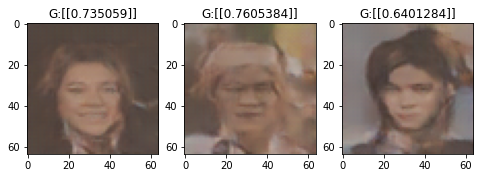

----------
Epoch 76/500
----------
Train Loss: 
G Loss : 0.6655
D Loss : 1.0692
----------
Epoch 77/500
----------
Train Loss: 
G Loss : 0.6606
D Loss : 1.0778
Model saved!


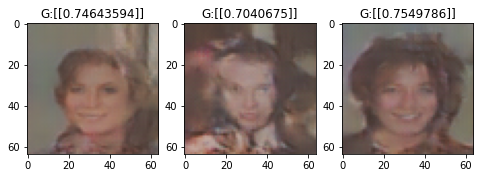

----------
Epoch 78/500
----------
Train Loss: 
G Loss : 0.6602
D Loss : 1.0765
----------
Epoch 79/500
----------
Train Loss: 
G Loss : 0.6588
D Loss : 1.0556
Model saved!


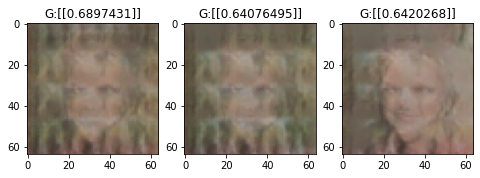

----------
Epoch 80/500
----------
Train Loss: 
G Loss : 0.6565
D Loss : 1.0947
----------
Epoch 81/500
----------
Train Loss: 
G Loss : 0.6633
D Loss : 1.0812
Model saved!


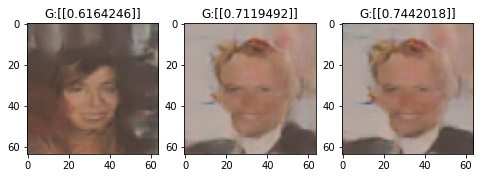

----------
Epoch 82/500
----------
Train Loss: 
G Loss : 0.6655
D Loss : 1.0594
----------
Epoch 83/500
----------
Train Loss: 
G Loss : 0.6672
D Loss : 1.0573
Model saved!


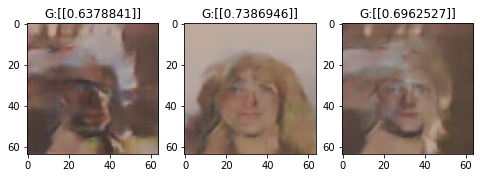

----------
Epoch 84/500
----------
Train Loss: 
G Loss : 0.6676
D Loss : 1.0584
----------
Epoch 85/500
----------
Train Loss: 
G Loss : 0.6698
D Loss : 1.0588
Model saved!


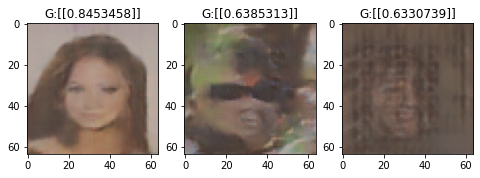

----------
Epoch 86/500
----------
Train Loss: 
G Loss : 0.6670
D Loss : 1.0504
----------
Epoch 87/500
----------
Train Loss: 
G Loss : 0.6610
D Loss : 1.0790
Model saved!


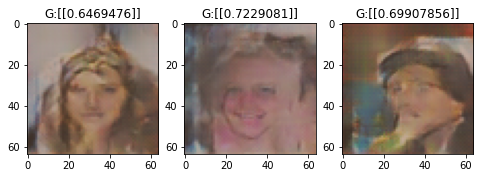

----------
Epoch 88/500
----------
Train Loss: 
G Loss : 0.6690
D Loss : 1.0606
----------
Epoch 89/500
----------
Train Loss: 
G Loss : 0.6680
D Loss : 1.0522
Model saved!


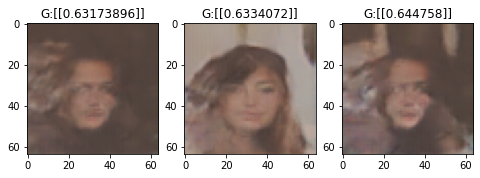

----------
Epoch 90/500
----------
Train Loss: 
G Loss : 0.6593
D Loss : 1.0694
----------
Epoch 91/500
----------
Train Loss: 
G Loss : 0.6746
D Loss : 1.0530
Model saved!


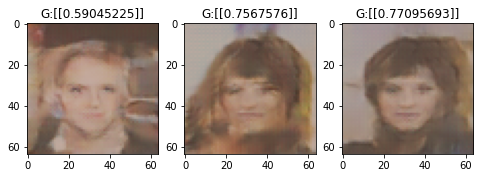

----------
Epoch 92/500
----------
Train Loss: 
G Loss : 0.6681
D Loss : 1.0609
----------
Epoch 93/500
----------
Train Loss: 
G Loss : 0.6697
D Loss : 1.0456
Model saved!


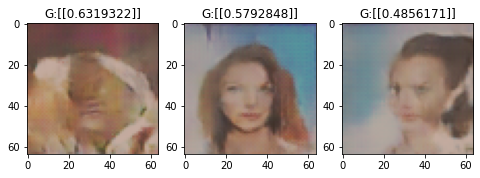

----------
Epoch 94/500
----------
Train Loss: 
G Loss : 0.6686
D Loss : 1.0540
----------
Epoch 95/500
----------
Train Loss: 
G Loss : 0.6721
D Loss : 1.0544
Model saved!


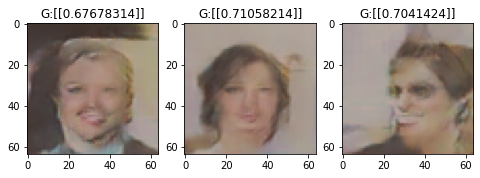

----------
Epoch 96/500
----------
Train Loss: 
G Loss : 0.6673
D Loss : 1.0500
----------
Epoch 97/500
----------
Train Loss: 
G Loss : 0.6688
D Loss : 1.0536
Model saved!


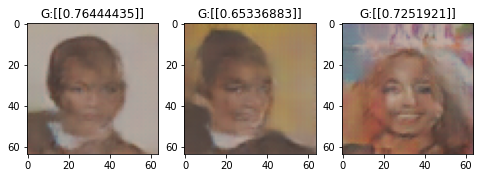

----------
Epoch 98/500
----------
Train Loss: 
G Loss : 0.6648
D Loss : 1.0648
----------
Epoch 99/500
----------
Train Loss: 
G Loss : 0.6666
D Loss : 1.0634
Model saved!


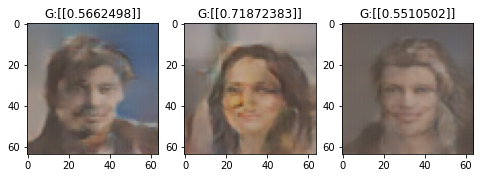

----------
Epoch 100/500
----------
Train Loss: 
G Loss : 0.6714
D Loss : 1.0482
----------
Epoch 101/500
----------
Train Loss: 
G Loss : 0.6686
D Loss : 1.0551
Model saved!


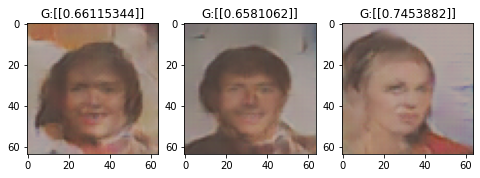

----------
Epoch 102/500
----------
Train Loss: 
G Loss : 0.6637
D Loss : 1.0640
----------
Epoch 103/500
----------
Train Loss: 
G Loss : 0.6743
D Loss : 1.0474
Model saved!


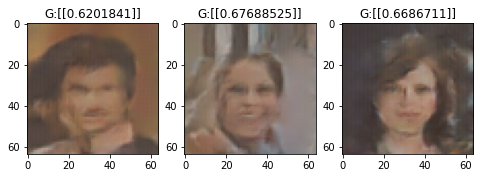

----------
Epoch 104/500
----------
Train Loss: 
G Loss : 0.6742
D Loss : 1.0407
----------
Epoch 105/500
----------
Train Loss: 
G Loss : 0.6694
D Loss : 1.0546
Model saved!


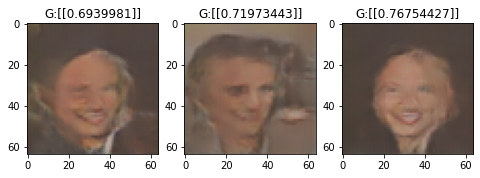

----------
Epoch 106/500
----------
Train Loss: 
G Loss : 0.6722
D Loss : 1.0486
----------
Epoch 107/500
----------
Train Loss: 
G Loss : 0.6861
D Loss : 1.0296
Model saved!


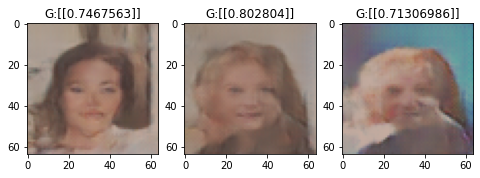

----------
Epoch 108/500
----------
Train Loss: 
G Loss : 0.6785
D Loss : 1.0352
----------
Epoch 109/500
----------
Train Loss: 
G Loss : 0.6705
D Loss : 1.0425
Model saved!


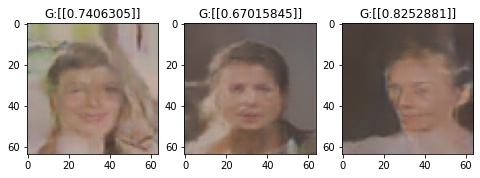

----------
Epoch 110/500
----------
Train Loss: 
G Loss : 0.6808
D Loss : 1.0292
----------
Epoch 111/500
----------
Train Loss: 
G Loss : 0.6713
D Loss : 1.0455
Model saved!


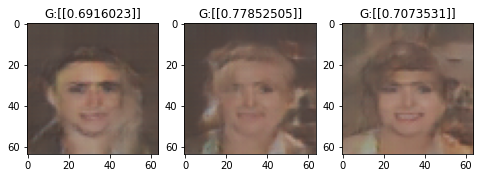

----------
Epoch 112/500
----------
Train Loss: 
G Loss : 0.6715
D Loss : 1.0360
----------
Epoch 113/500
----------
Train Loss: 
G Loss : 0.6771
D Loss : 1.0363
Model saved!


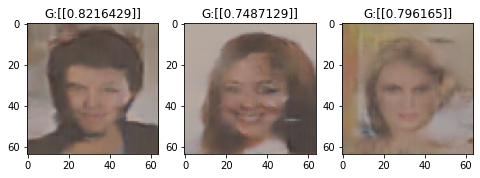

----------
Epoch 114/500
----------
Train Loss: 
G Loss : 0.6684
D Loss : 1.0471
----------
Epoch 115/500
----------
Train Loss: 
G Loss : 0.6699
D Loss : 1.0385
Model saved!


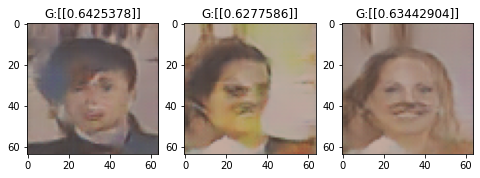

----------
Epoch 116/500
----------
Train Loss: 
G Loss : 0.6732
D Loss : 1.0464
----------
Epoch 117/500
----------
Train Loss: 
G Loss : 0.6679
D Loss : 1.0482
Model saved!


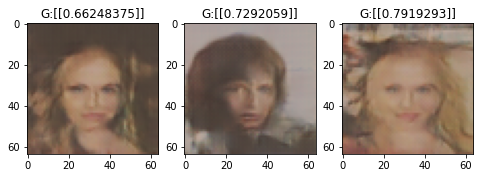

----------
Epoch 118/500
----------
Train Loss: 
G Loss : 0.6781
D Loss : 1.0547
----------
Epoch 119/500
----------
Train Loss: 
G Loss : 0.6753
D Loss : 1.0431
Model saved!


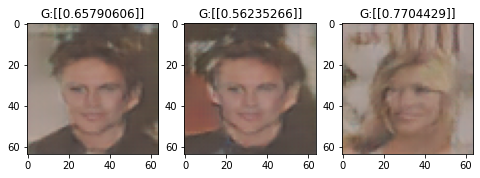

----------
Epoch 120/500
----------
Train Loss: 
G Loss : 0.6672
D Loss : 1.0448
----------
Epoch 121/500
----------
Train Loss: 
G Loss : 0.6674
D Loss : 1.0468
Model saved!


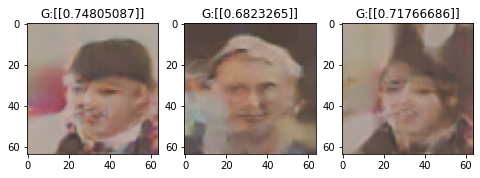

----------
Epoch 122/500
----------
Train Loss: 
G Loss : 0.6679
D Loss : 1.0466
----------
Epoch 123/500
----------
Train Loss: 
G Loss : 0.6705
D Loss : 1.0427
Model saved!


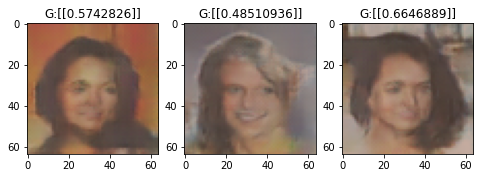

----------
Epoch 124/500
----------
Train Loss: 
G Loss : 0.6778
D Loss : 1.0423
----------
Epoch 125/500
----------
Train Loss: 
G Loss : 0.6780
D Loss : 1.0303
Model saved!


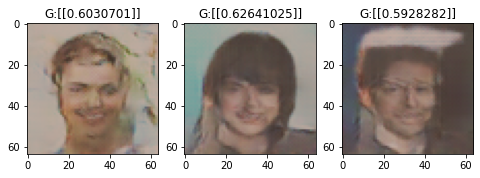

----------
Epoch 126/500
----------
Train Loss: 
G Loss : 0.6730
D Loss : 1.0358
----------
Epoch 127/500
----------
Train Loss: 
G Loss : 0.6787
D Loss : 1.0428
Model saved!


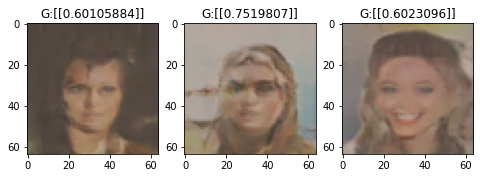

----------
Epoch 128/500
----------
Train Loss: 
G Loss : 0.6744
D Loss : 1.0264
----------
Epoch 129/500
----------
Train Loss: 
G Loss : 0.6821
D Loss : 1.0276
Model saved!


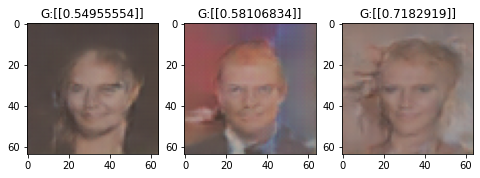

----------
Epoch 130/500
----------
Train Loss: 
G Loss : 0.6720
D Loss : 1.0383
----------
Epoch 131/500
----------
Train Loss: 
G Loss : 0.6795
D Loss : 1.0326
Model saved!


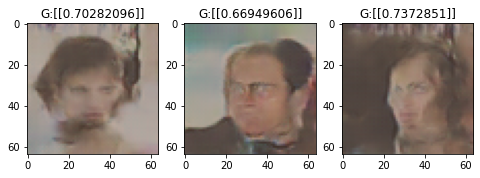

----------
Epoch 132/500
----------
Train Loss: 
G Loss : 0.6759
D Loss : 1.0382
----------
Epoch 133/500
----------
Train Loss: 
G Loss : 0.6806
D Loss : 1.0250
Model saved!


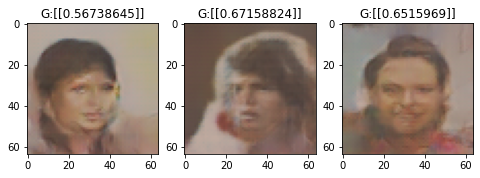

----------
Epoch 134/500
----------
Train Loss: 
G Loss : 0.6788
D Loss : 1.0315
----------
Epoch 135/500
----------
Train Loss: 
G Loss : 0.6731
D Loss : 1.0349
Model saved!


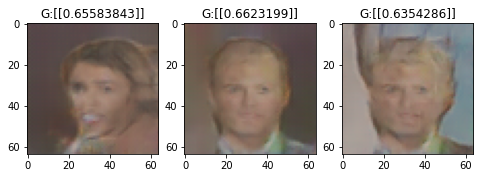

----------
Epoch 136/500
----------
Train Loss: 
G Loss : 0.6813
D Loss : 1.0273
----------
Epoch 137/500
----------
Train Loss: 
G Loss : 0.6774
D Loss : 1.0470
Model saved!


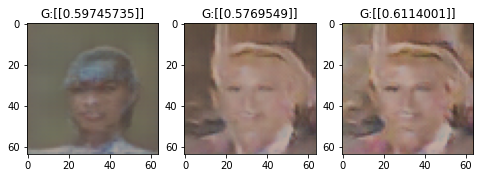

----------
Epoch 138/500
----------
Train Loss: 
G Loss : 0.6711
D Loss : 1.0237
----------
Epoch 139/500
----------
Train Loss: 
G Loss : 0.6829
D Loss : 1.0199
Model saved!


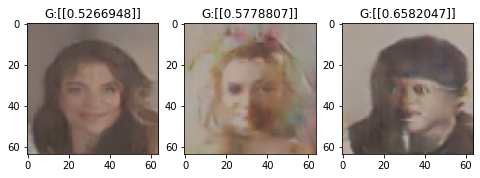

----------
Epoch 140/500
----------
Train Loss: 
G Loss : 0.6776
D Loss : 1.0305
----------
Epoch 141/500
----------
Train Loss: 
G Loss : 0.6834
D Loss : 1.0266
Model saved!


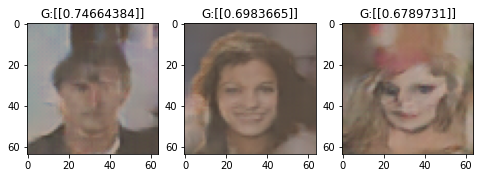

----------
Epoch 142/500
----------
Train Loss: 
G Loss : 0.6703
D Loss : 1.0318
----------
Epoch 143/500
----------
Train Loss: 
G Loss : 0.6734
D Loss : 1.0600
Model saved!


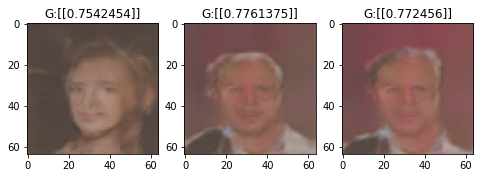

----------
Epoch 144/500
----------
Train Loss: 
G Loss : 0.6656
D Loss : 1.0552
----------
Epoch 145/500
----------
Train Loss: 
G Loss : 0.6700
D Loss : 1.0367
Model saved!


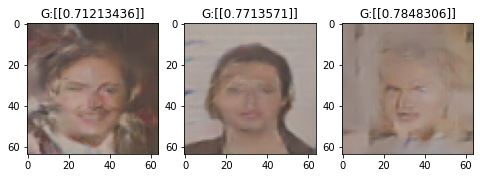

----------
Epoch 146/500
----------
Train Loss: 
G Loss : 0.6697
D Loss : 1.0444
----------
Epoch 147/500
----------
Train Loss: 
G Loss : 0.6825
D Loss : 1.0359
Model saved!


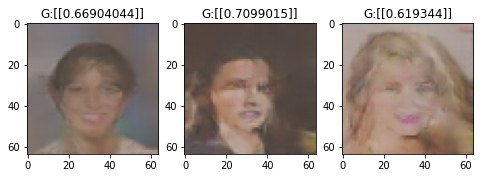

----------
Epoch 148/500
----------
Train Loss: 
G Loss : 0.6791
D Loss : 1.0357
----------
Epoch 149/500
----------
Train Loss: 
G Loss : 0.6838
D Loss : 1.0191
Model saved!


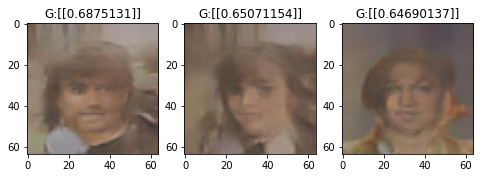

----------
Epoch 150/500
----------
Train Loss: 
G Loss : 0.6816
D Loss : 1.0140
----------
Epoch 151/500
----------
Train Loss: 
G Loss : 0.6818
D Loss : 1.0256
Model saved!


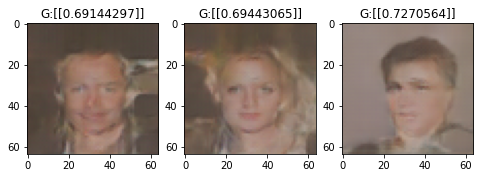

----------
Epoch 152/500
----------
Train Loss: 
G Loss : 0.6859
D Loss : 1.0257
----------
Epoch 153/500
----------
Train Loss: 
G Loss : 0.6790
D Loss : 1.0326
Model saved!


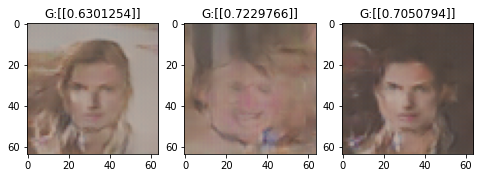

----------
Epoch 154/500
----------
Train Loss: 
G Loss : 0.6806
D Loss : 1.0177
----------
Epoch 155/500
----------
Train Loss: 
G Loss : 0.6831
D Loss : 1.0173
Model saved!


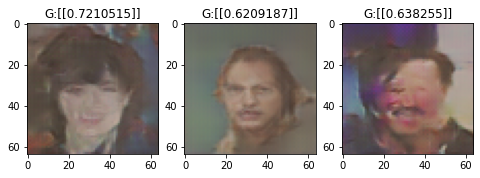

----------
Epoch 156/500
----------
Train Loss: 
G Loss : 0.6828
D Loss : 1.0171
----------
Epoch 157/500
----------
Train Loss: 
G Loss : 0.6824
D Loss : 1.0176
Model saved!


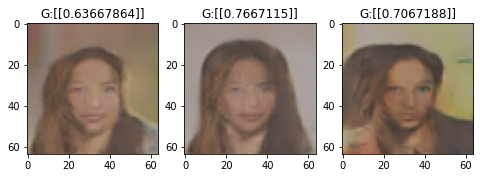

----------
Epoch 158/500
----------
Train Loss: 
G Loss : 0.6848
D Loss : 1.0172
----------
Epoch 159/500
----------
Train Loss: 
G Loss : 0.6881
D Loss : 1.0057
Model saved!


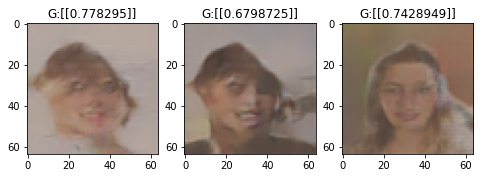

----------
Epoch 160/500
----------
Train Loss: 
G Loss : 0.6907
D Loss : 0.9977
----------
Epoch 161/500
----------
Train Loss: 
G Loss : 0.6906
D Loss : 1.0071
Model saved!


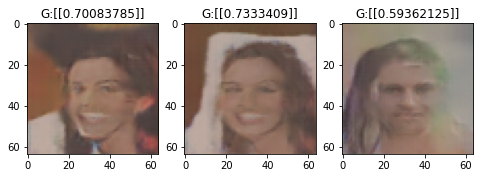

----------
Epoch 162/500
----------
Train Loss: 
G Loss : 0.6861
D Loss : 1.0145
----------
Epoch 163/500
----------
Train Loss: 
G Loss : 0.6908
D Loss : 1.0072
Model saved!


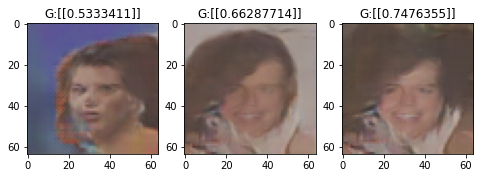

----------
Epoch 164/500
----------
Train Loss: 
G Loss : 0.6866
D Loss : 0.9939
----------
Epoch 165/500
----------
Train Loss: 
G Loss : 0.6849
D Loss : 1.0144
Model saved!


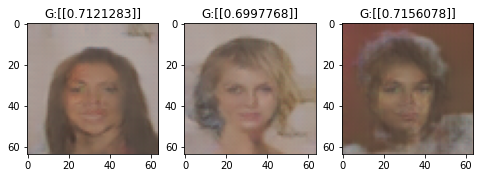

----------
Epoch 166/500
----------
Train Loss: 
G Loss : 0.6808
D Loss : 1.0307
----------
Epoch 167/500
----------
Train Loss: 
G Loss : 0.6854
D Loss : 1.0131
Model saved!


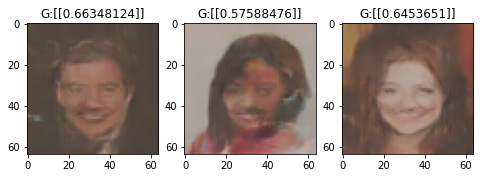

----------
Epoch 168/500
----------
Train Loss: 
G Loss : 0.6841
D Loss : 1.0074
----------
Epoch 169/500
----------
Train Loss: 
G Loss : 0.6876
D Loss : 1.0206
Model saved!


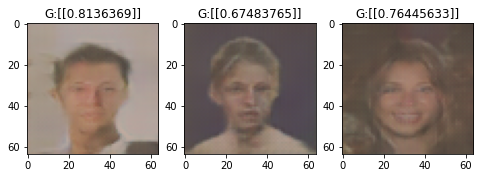

----------
Epoch 170/500
----------
Train Loss: 
G Loss : 0.6846
D Loss : 0.9955
----------
Epoch 171/500
----------
Train Loss: 
G Loss : 0.6875
D Loss : 1.0180
Model saved!


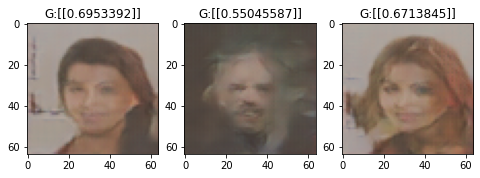

----------
Epoch 172/500
----------
Train Loss: 
G Loss : 0.6906
D Loss : 1.0095
----------
Epoch 173/500
----------
Train Loss: 
G Loss : 0.6882
D Loss : 0.9958
Model saved!


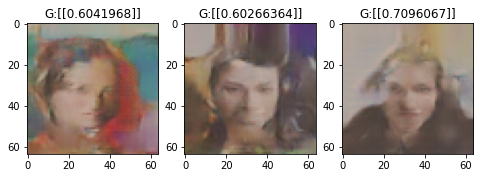

----------
Epoch 174/500
----------
Train Loss: 
G Loss : 0.6825
D Loss : 1.0177
----------
Epoch 175/500
----------
Train Loss: 
G Loss : 0.6932
D Loss : 1.0019
Model saved!


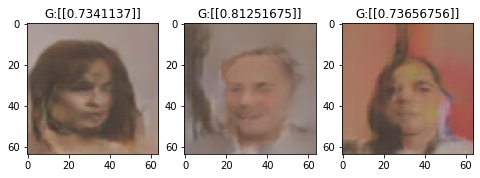

----------
Epoch 176/500
----------
Train Loss: 
G Loss : 0.6871
D Loss : 1.0141
----------
Epoch 177/500
----------
Train Loss: 
G Loss : 0.6821
D Loss : 1.0202
Model saved!


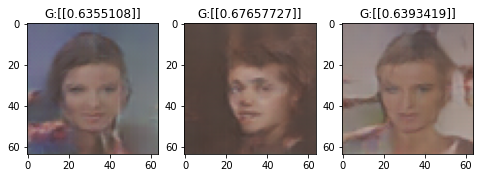

----------
Epoch 178/500
----------
Train Loss: 
G Loss : 0.6857
D Loss : 1.0064
----------
Epoch 179/500
----------
Train Loss: 
G Loss : 0.6887
D Loss : 0.9985
Model saved!


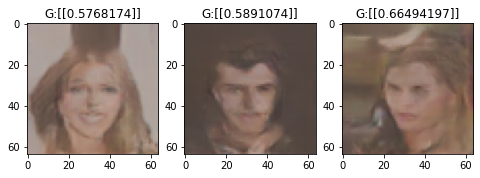

----------
Epoch 180/500
----------
Train Loss: 
G Loss : 0.6890
D Loss : 1.0087
----------
Epoch 181/500
----------
Train Loss: 
G Loss : 0.6883
D Loss : 1.0035
Model saved!


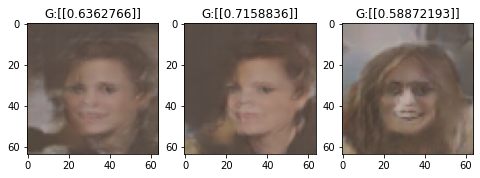

----------
Epoch 182/500
----------
Train Loss: 
G Loss : 0.6951
D Loss : 1.0008
----------
Epoch 183/500
----------
Train Loss: 
G Loss : 0.6848
D Loss : 1.0108
Model saved!


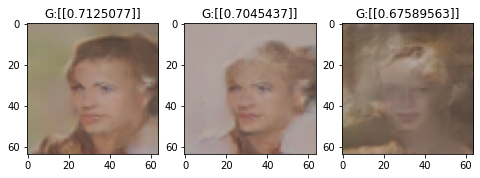

----------
Epoch 184/500
----------
Train Loss: 
G Loss : 0.6866
D Loss : 1.0097
----------
Epoch 185/500
----------
Train Loss: 
G Loss : 0.6964
D Loss : 0.9938
Model saved!


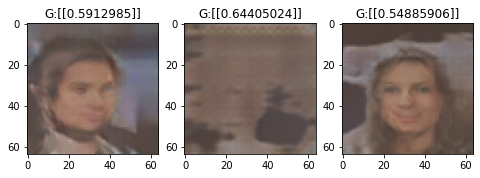

----------
Epoch 186/500
----------
Train Loss: 
G Loss : 0.6894
D Loss : 0.9962
----------
Epoch 187/500
----------
Train Loss: 
G Loss : 0.6894
D Loss : 0.9981
Model saved!


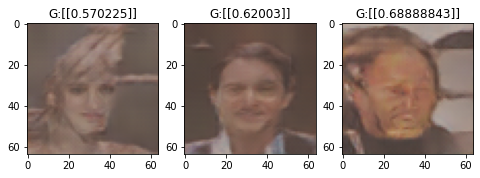

----------
Epoch 188/500
----------
Train Loss: 
G Loss : 0.6897
D Loss : 1.0113
----------
Epoch 189/500
----------
Train Loss: 
G Loss : 0.6893
D Loss : 1.0003
Model saved!


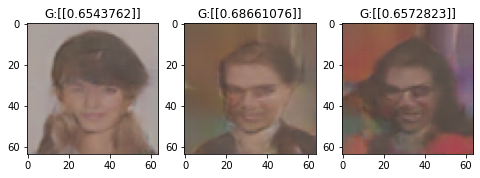

----------
Epoch 190/500
----------
Train Loss: 
G Loss : 0.6867
D Loss : 1.0008
----------
Epoch 191/500
----------
Train Loss: 
G Loss : 0.6950
D Loss : 0.9990
Model saved!


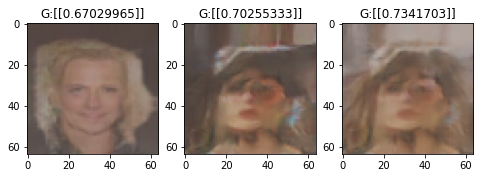

----------
Epoch 192/500
----------
Train Loss: 
G Loss : 0.6915
D Loss : 0.9888
----------
Epoch 193/500
----------
Train Loss: 
G Loss : 0.6884
D Loss : 0.9957
Model saved!


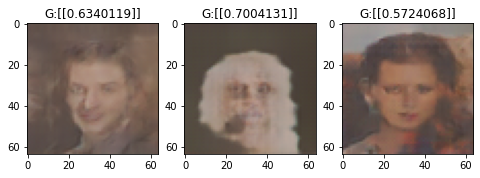

----------
Epoch 194/500
----------
Train Loss: 
G Loss : 0.6911
D Loss : 0.9987
----------
Epoch 195/500
----------
Train Loss: 
G Loss : 0.6964
D Loss : 1.0011
Model saved!


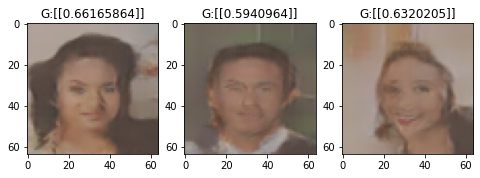

----------
Epoch 196/500
----------
Train Loss: 
G Loss : 0.6972
D Loss : 0.9894
----------
Epoch 197/500
----------
Train Loss: 
G Loss : 0.6923
D Loss : 1.0010
Model saved!


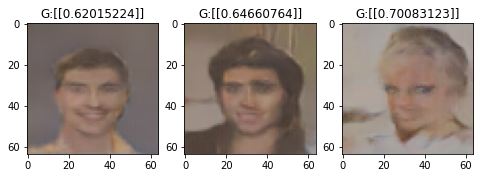

----------
Epoch 198/500
----------
Train Loss: 
G Loss : 0.6897
D Loss : 0.9998
----------
Epoch 199/500
----------
Train Loss: 
G Loss : 0.6917
D Loss : 0.9984
Model saved!


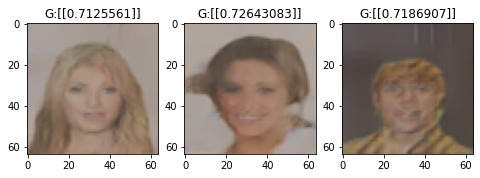

----------
Epoch 200/500
----------
Train Loss: 
G Loss : 0.6894
D Loss : 0.9969
----------
Epoch 201/500
----------
Train Loss: 
G Loss : 0.6947
D Loss : 0.9856
Model saved!


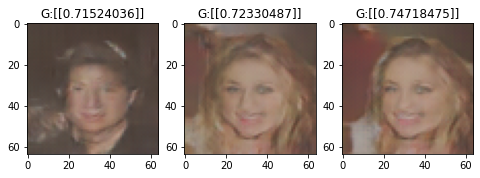

----------
Epoch 202/500
----------
Train Loss: 
G Loss : 0.6995
D Loss : 0.9929
----------
Epoch 203/500
----------
Train Loss: 
G Loss : 0.6917
D Loss : 0.9983
Model saved!


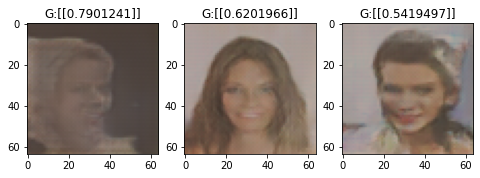

----------
Epoch 204/500
----------
Train Loss: 
G Loss : 0.6951
D Loss : 0.9929
----------
Epoch 205/500
----------
Train Loss: 
G Loss : 0.6953
D Loss : 0.9903
Model saved!


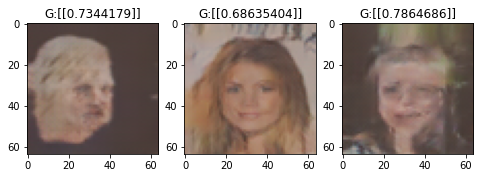

----------
Epoch 206/500
----------
Train Loss: 
G Loss : 0.6965
D Loss : 0.9999
----------
Epoch 207/500
----------
Train Loss: 
G Loss : 0.6941
D Loss : 0.9849
Model saved!


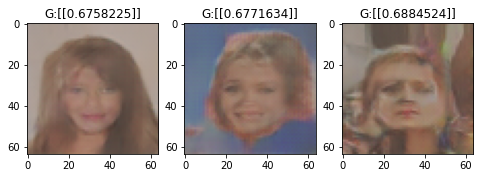

----------
Epoch 208/500
----------
Train Loss: 
G Loss : 0.6935
D Loss : 0.9867
----------
Epoch 209/500
----------
Train Loss: 
G Loss : 0.6983
D Loss : 0.9845
Model saved!


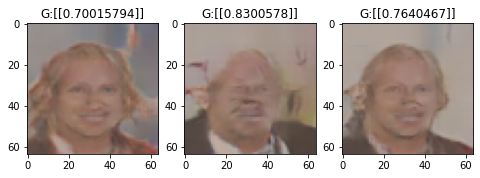

----------
Epoch 210/500
----------
Train Loss: 
G Loss : 0.7028
D Loss : 0.9832
----------
Epoch 211/500
----------
Train Loss: 
G Loss : 0.6968
D Loss : 0.9889
Model saved!


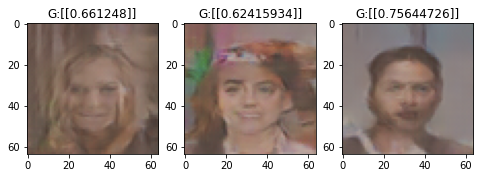

----------
Epoch 212/500
----------
Train Loss: 
G Loss : 0.6931
D Loss : 0.9939
----------
Epoch 213/500
----------
Train Loss: 
G Loss : 0.6952
D Loss : 0.9821
Model saved!


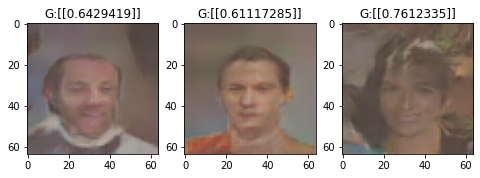

----------
Epoch 214/500
----------
Train Loss: 
G Loss : 0.6936
D Loss : 0.9947
----------
Epoch 215/500
----------
Train Loss: 
G Loss : 0.6927
D Loss : 0.9992
Model saved!


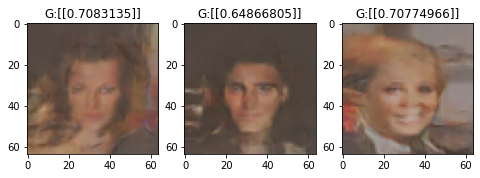

----------
Epoch 216/500
----------
Train Loss: 
G Loss : 0.6921
D Loss : 0.9963
----------
Epoch 217/500
----------
Train Loss: 
G Loss : 0.6956
D Loss : 0.9774
Model saved!


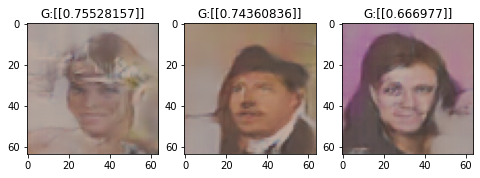

----------
Epoch 218/500
----------
Train Loss: 
G Loss : 0.6987
D Loss : 0.9821
----------
Epoch 219/500
----------
Train Loss: 
G Loss : 0.6961
D Loss : 0.9888
Model saved!


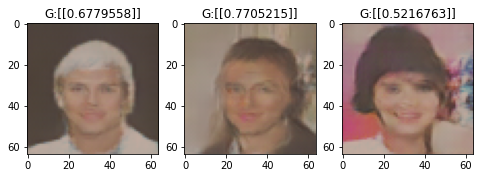

----------
Epoch 220/500
----------
Train Loss: 
G Loss : 0.7001
D Loss : 0.9810
----------
Epoch 221/500
----------
Train Loss: 
G Loss : 0.6927
D Loss : 0.9850
Model saved!


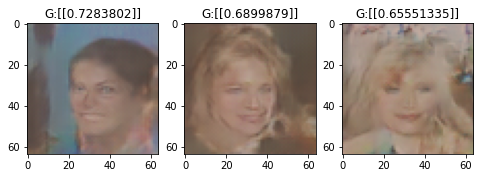

----------
Epoch 222/500
----------
Train Loss: 
G Loss : 0.6956
D Loss : 0.9864
----------
Epoch 223/500
----------
Train Loss: 
G Loss : 0.6972
D Loss : 0.9861
Model saved!


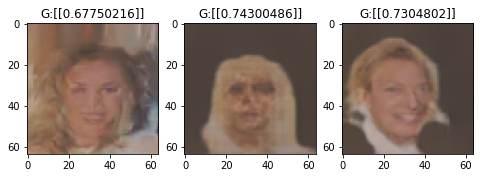

----------
Epoch 224/500
----------
Train Loss: 
G Loss : 0.7019
D Loss : 0.9775
----------
Epoch 225/500
----------
Train Loss: 
G Loss : 0.7070
D Loss : 0.9789
Model saved!


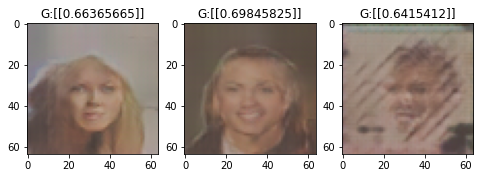

----------
Epoch 226/500
----------
Train Loss: 
G Loss : 0.6926
D Loss : 0.9771
----------
Epoch 227/500
----------
Train Loss: 
G Loss : 0.7082
D Loss : 0.9711
Model saved!


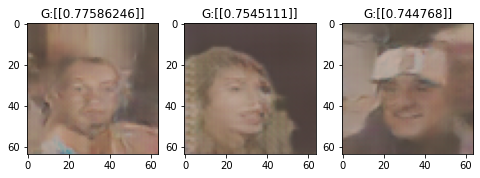

----------
Epoch 228/500
----------
Train Loss: 
G Loss : 0.7004
D Loss : 0.9882
----------
Epoch 229/500
----------
Train Loss: 
G Loss : 0.7062
D Loss : 0.9663
Model saved!


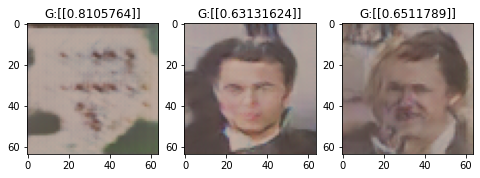

----------
Epoch 230/500
----------
Train Loss: 
G Loss : 0.6954
D Loss : 0.9784
----------
Epoch 231/500
----------
Train Loss: 
G Loss : 0.6971
D Loss : 0.9832
Model saved!


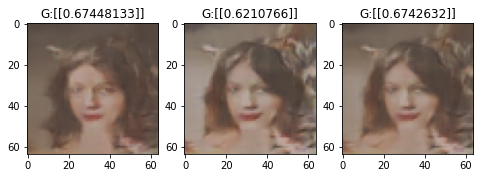

----------
Epoch 232/500
----------
Train Loss: 
G Loss : 0.6999
D Loss : 0.9791
----------
Epoch 233/500
----------
Train Loss: 
G Loss : 0.6904
D Loss : 0.9940
Model saved!


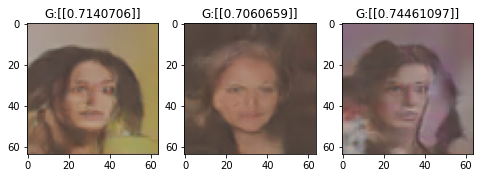

----------
Epoch 234/500
----------
Train Loss: 
G Loss : 0.6930
D Loss : 0.9895
----------
Epoch 235/500
----------
Train Loss: 
G Loss : 0.6948
D Loss : 0.9825
Model saved!


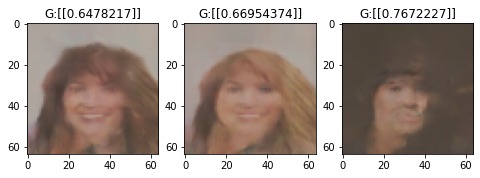

----------
Epoch 236/500
----------
Train Loss: 
G Loss : 0.6942
D Loss : 0.9903
----------
Epoch 237/500
----------
Train Loss: 
G Loss : 0.6999
D Loss : 0.9834
Model saved!


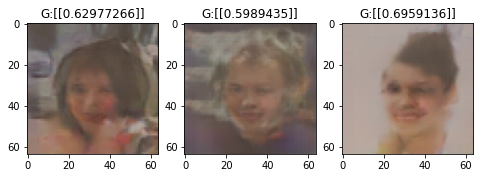

----------
Epoch 238/500
----------
Train Loss: 
G Loss : 0.7008
D Loss : 0.9726
----------
Epoch 239/500
----------
Train Loss: 
G Loss : 0.7058
D Loss : 0.9798
Model saved!


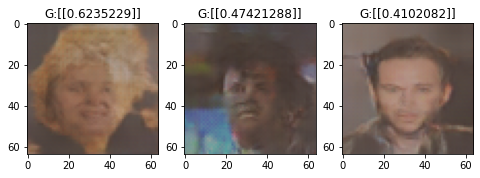

----------
Epoch 240/500
----------
Train Loss: 
G Loss : 0.7009
D Loss : 0.9631
----------
Epoch 241/500
----------
Train Loss: 
G Loss : 0.7013
D Loss : 0.9743
Model saved!


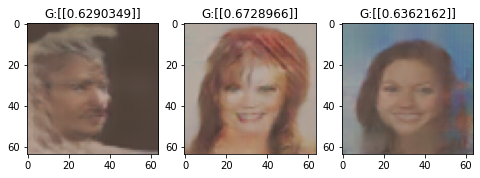

----------
Epoch 242/500
----------
Train Loss: 
G Loss : 0.7099
D Loss : 0.9638
----------
Epoch 243/500
----------
Train Loss: 
G Loss : 0.7189
D Loss : 0.9418
Model saved!


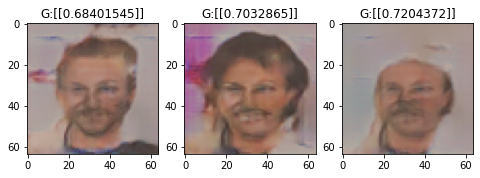

----------
Epoch 244/500
----------
Train Loss: 
G Loss : 0.6982
D Loss : 0.9859
----------
Epoch 245/500
----------
Train Loss: 
G Loss : 0.7014
D Loss : 0.9642
Model saved!


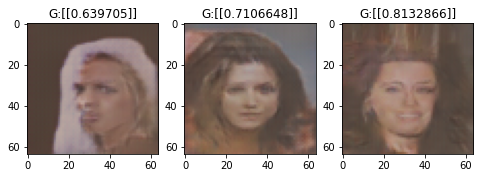

----------
Epoch 246/500
----------
Train Loss: 
G Loss : 0.7036
D Loss : 0.9615
----------
Epoch 247/500
----------
Train Loss: 
G Loss : 0.7041
D Loss : 0.9713
Model saved!


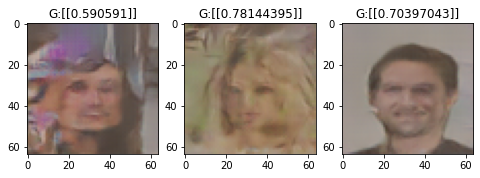

----------
Epoch 248/500
----------
Train Loss: 
G Loss : 0.7049
D Loss : 0.9713
----------
Epoch 249/500
----------
Train Loss: 
G Loss : 0.6979
D Loss : 0.9716
Model saved!


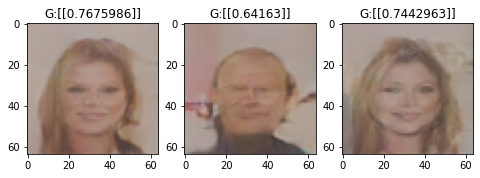

----------
Epoch 250/500
----------
Train Loss: 
G Loss : 0.7071
D Loss : 0.9669
----------
Epoch 251/500
----------
Train Loss: 
G Loss : 0.7011
D Loss : 0.9718
Model saved!


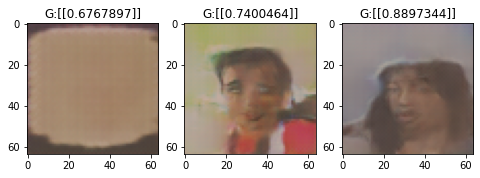

----------
Epoch 252/500
----------
Train Loss: 
G Loss : 0.7044
D Loss : 0.9613
----------
Epoch 253/500
----------
Train Loss: 
G Loss : 0.7099
D Loss : 0.9591
Model saved!


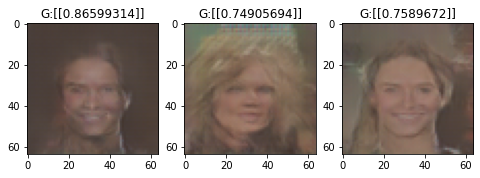

----------
Epoch 254/500
----------
Train Loss: 
G Loss : 0.7059
D Loss : 0.9742
----------
Epoch 255/500
----------
Train Loss: 
G Loss : 0.7039
D Loss : 0.9645
Model saved!


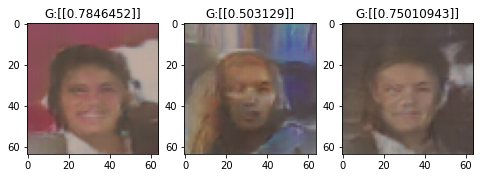

----------
Epoch 256/500
----------
Train Loss: 
G Loss : 0.7106
D Loss : 0.9562
----------
Epoch 257/500
----------
Train Loss: 
G Loss : 0.7012
D Loss : 0.9723
Model saved!


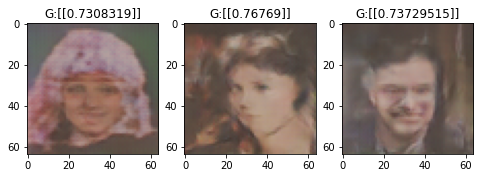

----------
Epoch 258/500
----------
Train Loss: 
G Loss : 0.6999
D Loss : 0.9682
----------
Epoch 259/500
----------
Train Loss: 
G Loss : 0.7080
D Loss : 0.9700
Model saved!


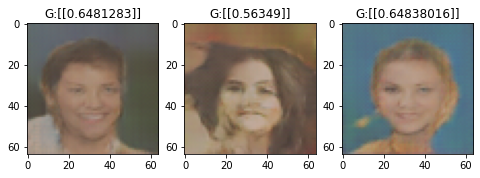

----------
Epoch 260/500
----------
Train Loss: 
G Loss : 0.6958
D Loss : 0.9772
----------
Epoch 261/500
----------
Train Loss: 
G Loss : 0.6965
D Loss : 0.9705
Model saved!


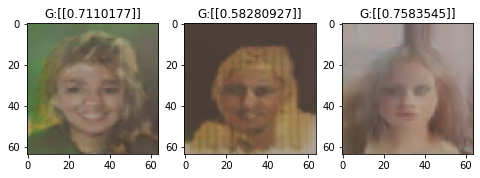

----------
Epoch 262/500
----------
Train Loss: 
G Loss : 0.7076
D Loss : 0.9804
----------
Epoch 263/500
----------
Train Loss: 
G Loss : 0.6967
D Loss : 0.9715
Model saved!


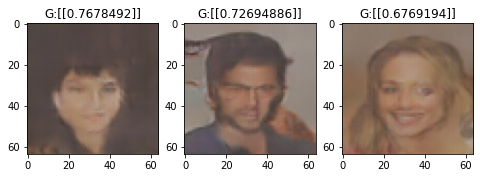

----------
Epoch 264/500
----------
Train Loss: 
G Loss : 0.7001
D Loss : 0.9727
----------
Epoch 265/500
----------
Train Loss: 
G Loss : 0.7077
D Loss : 0.9704
Model saved!


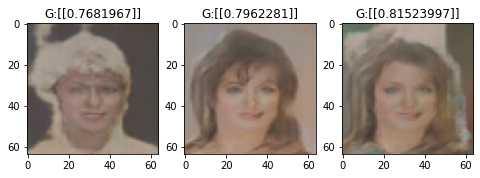

----------
Epoch 266/500
----------
Train Loss: 
G Loss : 0.7001
D Loss : 0.9591
----------
Epoch 267/500
----------
Train Loss: 
G Loss : 0.7037
D Loss : 0.9686
Model saved!


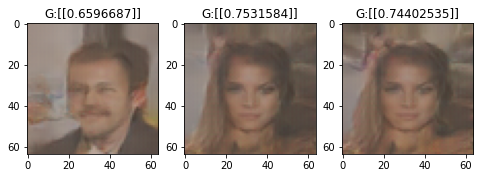

----------
Epoch 268/500
----------
Train Loss: 
G Loss : 0.7045
D Loss : 0.9669
----------
Epoch 269/500
----------
Train Loss: 
G Loss : 0.7029
D Loss : 0.9728
Model saved!


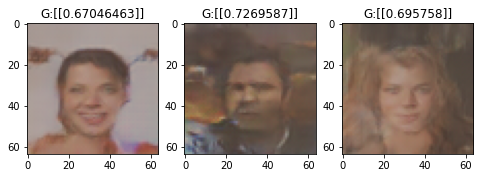

----------
Epoch 270/500
----------
Train Loss: 
G Loss : 0.7095
D Loss : 0.9550
----------
Epoch 271/500
----------
Train Loss: 
G Loss : 0.7041
D Loss : 0.9681
Model saved!


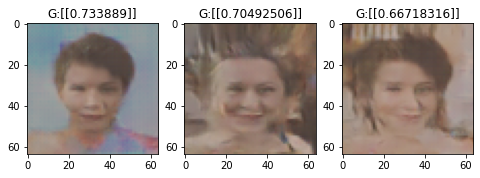

----------
Epoch 272/500
----------
Train Loss: 
G Loss : 0.7083
D Loss : 0.9560
----------
Epoch 273/500
----------
Train Loss: 
G Loss : 0.7067
D Loss : 0.9590
Model saved!


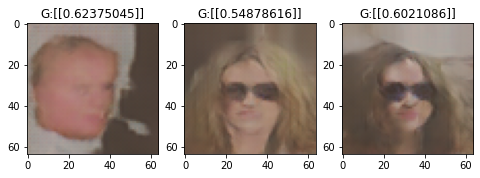

----------
Epoch 274/500
----------
Train Loss: 
G Loss : 0.7103
D Loss : 0.9603
----------
Epoch 275/500
----------
Train Loss: 
G Loss : 0.6972
D Loss : 0.9680
Model saved!


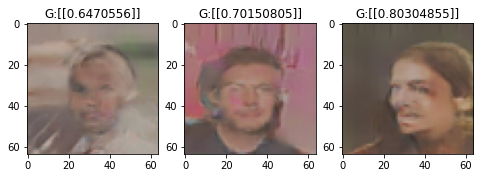

----------
Epoch 276/500
----------
Train Loss: 
G Loss : 0.7082
D Loss : 0.9645
----------
Epoch 277/500
----------
Train Loss: 
G Loss : 0.7091
D Loss : 0.9595
Model saved!


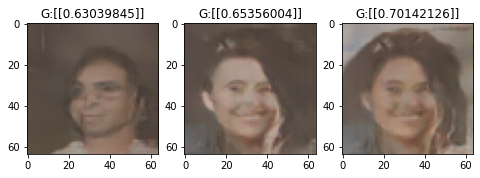

----------
Epoch 278/500
----------
Train Loss: 
G Loss : 0.7032
D Loss : 0.9670
----------
Epoch 279/500
----------
Train Loss: 
G Loss : 0.7097
D Loss : 0.9522
Model saved!


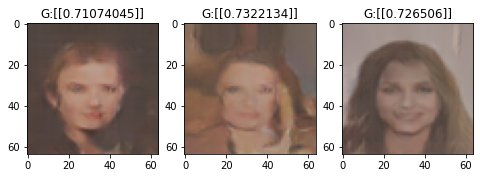

----------
Epoch 280/500
----------
Train Loss: 
G Loss : 0.7080
D Loss : 0.9577
----------
Epoch 281/500
----------
Train Loss: 
G Loss : 0.7058
D Loss : 0.9548
Model saved!


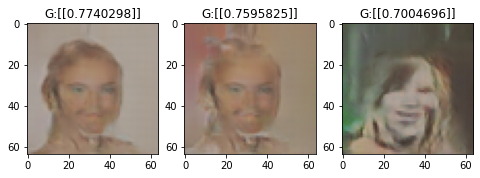

----------
Epoch 282/500
----------
Train Loss: 
G Loss : 0.7128
D Loss : 0.9576
----------
Epoch 283/500
----------
Train Loss: 
G Loss : 0.7024
D Loss : 0.9617
Model saved!


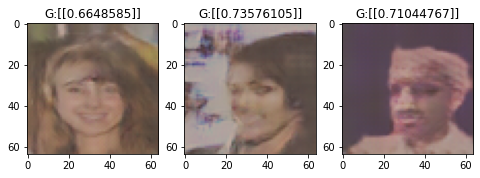

----------
Epoch 284/500
----------
Train Loss: 
G Loss : 0.7058
D Loss : 0.9578
----------
Epoch 285/500
----------
Train Loss: 
G Loss : 0.7054
D Loss : 0.9663
Model saved!


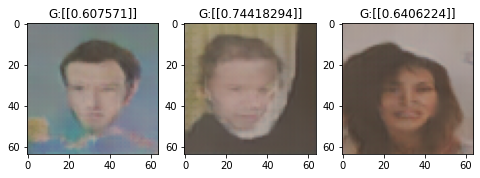

----------
Epoch 286/500
----------
Train Loss: 
G Loss : 0.7049
D Loss : 0.9594
----------
Epoch 287/500
----------
Train Loss: 
G Loss : 0.7068
D Loss : 0.9613
Model saved!


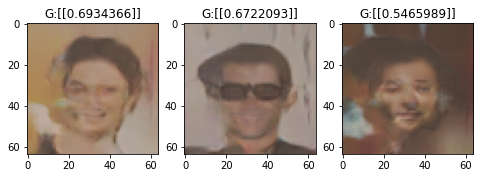

----------
Epoch 288/500
----------
Train Loss: 
G Loss : 0.7087
D Loss : 0.9622
----------
Epoch 289/500
----------
Train Loss: 
G Loss : 0.7038
D Loss : 0.9652
Model saved!


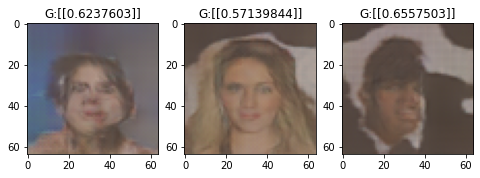

----------
Epoch 290/500
----------
Train Loss: 
G Loss : 0.7075
D Loss : 0.9587
----------
Epoch 291/500
----------
Train Loss: 
G Loss : 0.7110
D Loss : 0.9512
Model saved!


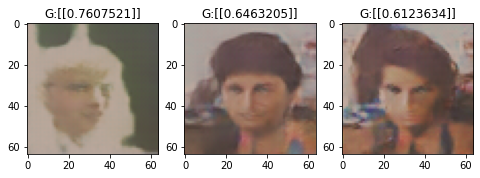

----------
Epoch 292/500
----------
Train Loss: 
G Loss : 0.7000
D Loss : 0.9729
----------
Epoch 293/500
----------
Train Loss: 
G Loss : 0.7019
D Loss : 0.9613
Model saved!


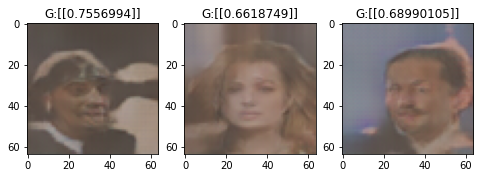

----------
Epoch 294/500
----------
Train Loss: 
G Loss : 0.7071
D Loss : 0.9657
----------
Epoch 295/500
----------
Train Loss: 
G Loss : 0.7020
D Loss : 0.9539
Model saved!


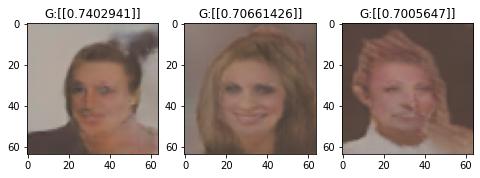

----------
Epoch 296/500
----------
Train Loss: 
G Loss : 0.7071
D Loss : 0.9591
----------
Epoch 297/500
----------
Train Loss: 
G Loss : 0.7094
D Loss : 0.9635
Model saved!


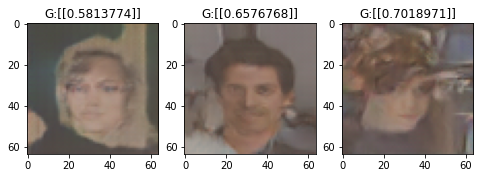

----------
Epoch 298/500
----------
Train Loss: 
G Loss : 0.7075
D Loss : 0.9546
----------
Epoch 299/500
----------
Train Loss: 
G Loss : 0.7100
D Loss : 0.9532
Model saved!


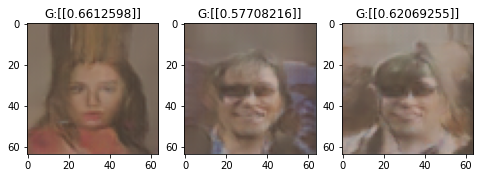

----------
Epoch 300/500
----------
Train Loss: 
G Loss : 0.7082
D Loss : 0.9633
----------
Epoch 301/500
----------
Train Loss: 
G Loss : 0.7000
D Loss : 0.9636
Model saved!


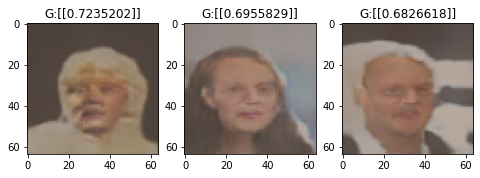

----------
Epoch 302/500
----------
Train Loss: 
G Loss : 0.7069
D Loss : 0.9592
----------
Epoch 303/500
----------
Train Loss: 
G Loss : 0.7083
D Loss : 0.9521
Model saved!


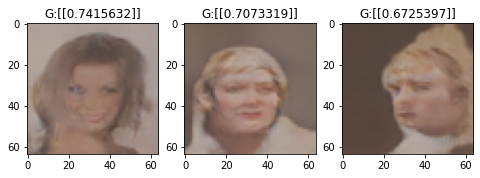

----------
Epoch 304/500
----------
Train Loss: 
G Loss : 0.7108
D Loss : 0.9564
----------
Epoch 305/500
----------
Train Loss: 
G Loss : 0.7144
D Loss : 0.9470
Model saved!


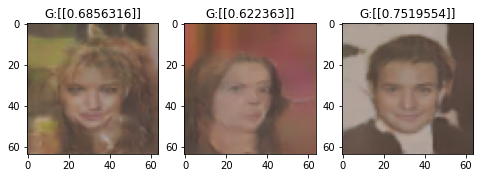

----------
Epoch 306/500
----------
Train Loss: 
G Loss : 0.7039
D Loss : 0.9519
----------
Epoch 307/500
----------
Train Loss: 
G Loss : 0.7061
D Loss : 0.9543
Model saved!


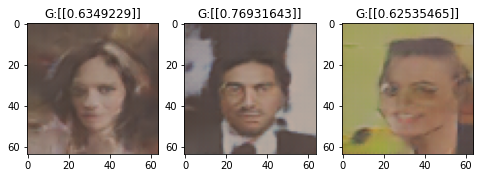

----------
Epoch 308/500
----------
Train Loss: 
G Loss : 0.7133
D Loss : 0.9459
----------
Epoch 309/500
----------
Train Loss: 
G Loss : 0.7121
D Loss : 0.9480
Model saved!


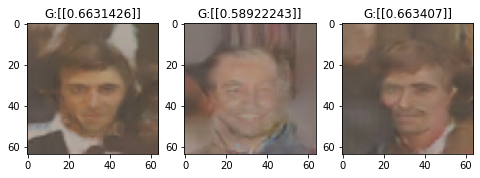

----------
Epoch 310/500
----------
Train Loss: 
G Loss : 0.7065
D Loss : 0.9528
----------
Epoch 311/500
----------
Train Loss: 
G Loss : 0.7064
D Loss : 0.9625
Model saved!


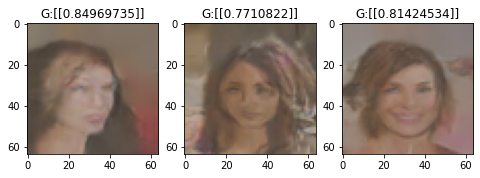

----------
Epoch 312/500
----------
Train Loss: 
G Loss : 0.7109
D Loss : 0.9569
----------
Epoch 313/500
----------
Train Loss: 
G Loss : 0.7066
D Loss : 0.9555
Model saved!


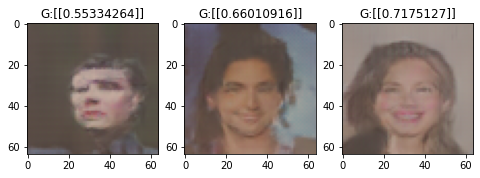

----------
Epoch 314/500
----------
Train Loss: 
G Loss : 0.7098
D Loss : 0.9538
----------
Epoch 315/500
----------
Train Loss: 
G Loss : 0.7054
D Loss : 0.9472
Model saved!


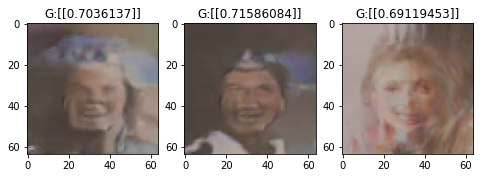

----------
Epoch 316/500
----------
Train Loss: 
G Loss : 0.7093
D Loss : 0.9633
----------
Epoch 317/500
----------
Train Loss: 
G Loss : 0.7111
D Loss : 0.9511
Model saved!


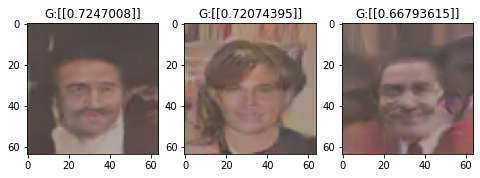

----------
Epoch 318/500
----------
Train Loss: 
G Loss : 0.7107
D Loss : 0.9446
----------
Epoch 319/500
----------
Train Loss: 
G Loss : 0.7216
D Loss : 0.9405
Model saved!


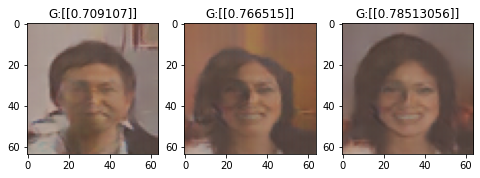

----------
Epoch 320/500
----------
Train Loss: 
G Loss : 0.7120
D Loss : 0.9443
----------
Epoch 321/500
----------
Train Loss: 
G Loss : 0.7154
D Loss : 0.9567
Model saved!


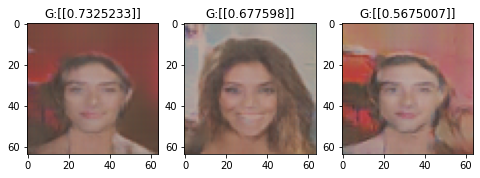

----------
Epoch 322/500
----------
Train Loss: 
G Loss : 0.7034
D Loss : 0.9527
----------
Epoch 323/500
----------
Train Loss: 
G Loss : 0.7065
D Loss : 0.9409
Model saved!


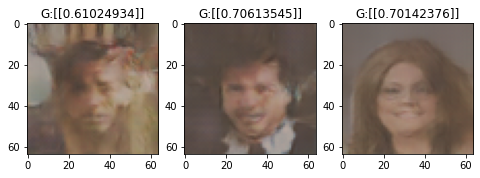

----------
Epoch 324/500
----------
Train Loss: 
G Loss : 0.7083
D Loss : 0.9487
----------
Epoch 325/500
----------
Train Loss: 
G Loss : 0.7085
D Loss : 0.9422
Model saved!


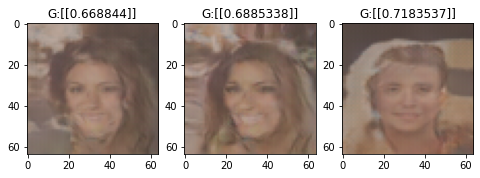

----------
Epoch 326/500
----------
Train Loss: 
G Loss : 0.7065
D Loss : 0.9553
----------
Epoch 327/500
----------
Train Loss: 
G Loss : 0.7135
D Loss : 0.9545
Model saved!


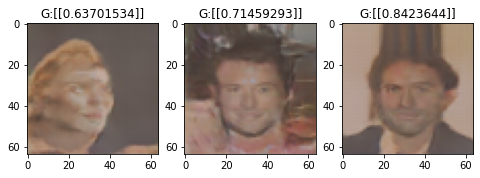

----------
Epoch 328/500
----------
Train Loss: 
G Loss : 0.7075
D Loss : 0.9425
----------
Epoch 329/500
----------
Train Loss: 
G Loss : 0.7153
D Loss : 0.9469
Model saved!


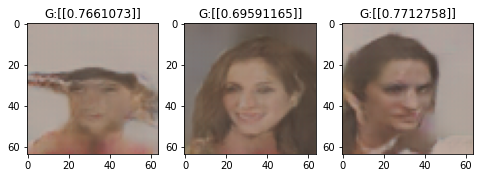

----------
Epoch 330/500
----------
Train Loss: 
G Loss : 0.7124
D Loss : 0.9402
----------
Epoch 331/500
----------
Train Loss: 
G Loss : 0.7134
D Loss : 0.9452
Model saved!


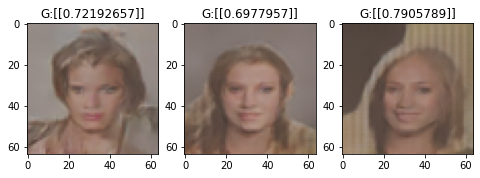

----------
Epoch 332/500
----------
Train Loss: 
G Loss : 0.7097
D Loss : 0.9443
----------
Epoch 333/500
----------
Train Loss: 
G Loss : 0.7178
D Loss : 0.9447
Model saved!


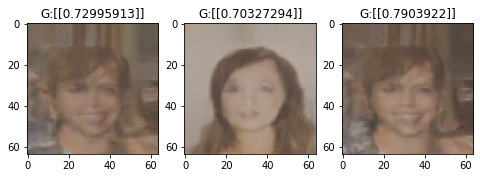

----------
Epoch 334/500
----------
Train Loss: 
G Loss : 0.7078
D Loss : 0.9497
----------
Epoch 335/500
----------
Train Loss: 
G Loss : 0.7118
D Loss : 0.9358
Model saved!


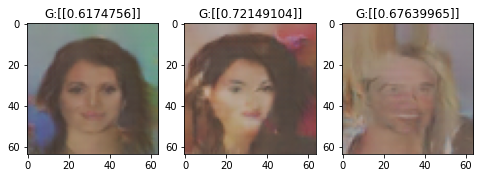

----------
Epoch 336/500
----------
Train Loss: 
G Loss : 0.7171
D Loss : 0.9434
----------
Epoch 337/500
----------
Train Loss: 
G Loss : 0.7171
D Loss : 0.9282
Model saved!


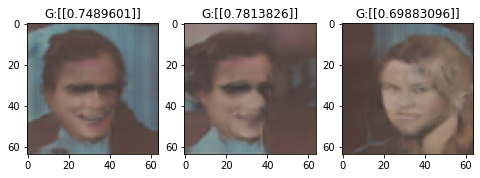

----------
Epoch 338/500
----------
Train Loss: 
G Loss : 0.7289
D Loss : 0.9232
----------
Epoch 339/500
----------
Train Loss: 
G Loss : 0.7227
D Loss : 0.9347
Model saved!


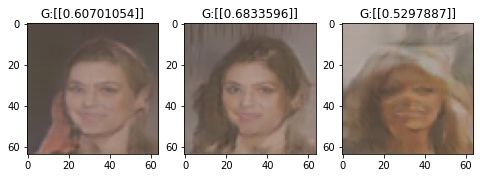

----------
Epoch 340/500
----------
Train Loss: 
G Loss : 0.7152
D Loss : 0.9363
----------
Epoch 341/500
----------
Train Loss: 
G Loss : 0.7200
D Loss : 0.9289
Model saved!


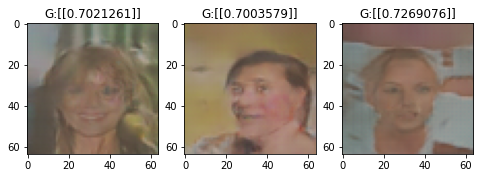

----------
Epoch 342/500
----------
Train Loss: 
G Loss : 0.7144
D Loss : 0.9480
----------
Epoch 343/500
----------
Train Loss: 
G Loss : 0.7176
D Loss : 0.9298
Model saved!


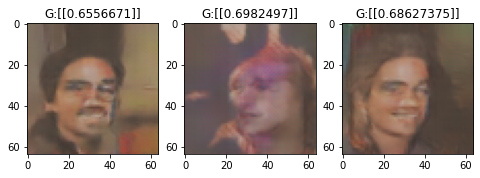

----------
Epoch 344/500
----------
Train Loss: 
G Loss : 0.7135
D Loss : 0.9410
----------
Epoch 345/500
----------
Train Loss: 
G Loss : 0.7136
D Loss : 0.9351
Model saved!


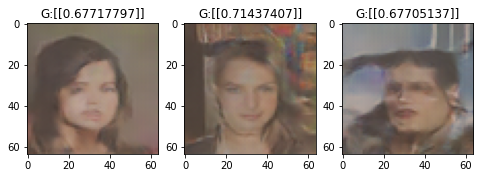

----------
Epoch 346/500
----------
Train Loss: 
G Loss : 0.7088
D Loss : 0.9459
----------
Epoch 347/500
----------
Train Loss: 
G Loss : 0.7110
D Loss : 0.9425
Model saved!


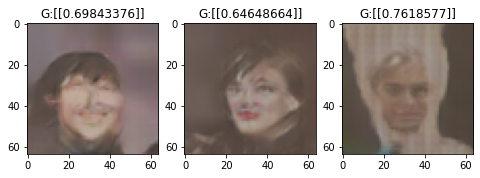

----------
Epoch 348/500
----------
Train Loss: 
G Loss : 0.7114
D Loss : 0.9416
----------
Epoch 349/500
----------
Train Loss: 
G Loss : 0.7143
D Loss : 0.9510
Model saved!


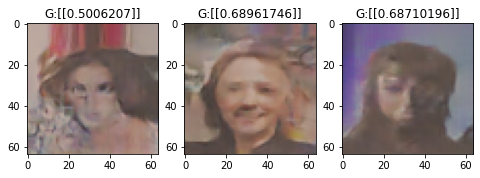

----------
Epoch 350/500
----------
Train Loss: 
G Loss : 0.7144
D Loss : 0.9405
----------
Epoch 351/500
----------
Train Loss: 
G Loss : 0.7100
D Loss : 0.9381
Model saved!


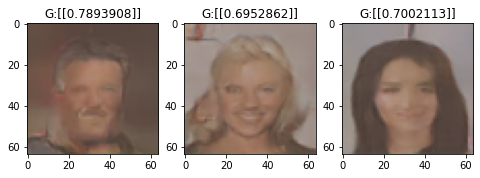

----------
Epoch 352/500
----------
Train Loss: 
G Loss : 0.7153
D Loss : 0.9465
----------
Epoch 353/500
----------
Train Loss: 
G Loss : 0.7148
D Loss : 0.9378
Model saved!


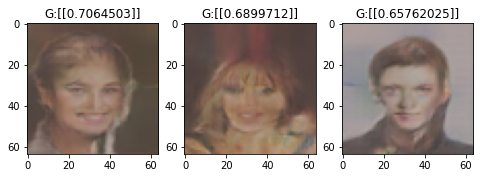

----------
Epoch 354/500
----------
Train Loss: 
G Loss : 0.7196
D Loss : 0.9365
----------
Epoch 355/500
----------
Train Loss: 
G Loss : 0.7141
D Loss : 0.9422
Model saved!


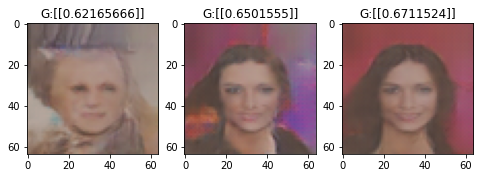

----------
Epoch 356/500
----------
Train Loss: 
G Loss : 0.7093
D Loss : 0.9409
----------
Epoch 357/500
----------
Train Loss: 
G Loss : 0.7113
D Loss : 0.9389
Model saved!


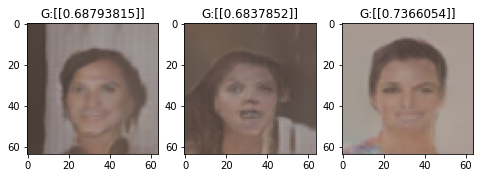

----------
Epoch 358/500
----------
Train Loss: 
G Loss : 0.7084
D Loss : 0.9501
----------
Epoch 359/500
----------
Train Loss: 
G Loss : 0.7107
D Loss : 0.9401
Model saved!


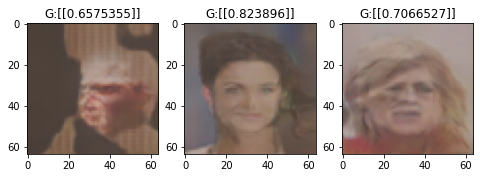

----------
Epoch 360/500
----------
Train Loss: 
G Loss : 0.7117
D Loss : 0.9485
----------
Epoch 361/500
----------
Train Loss: 
G Loss : 0.7081
D Loss : 0.9413
Model saved!


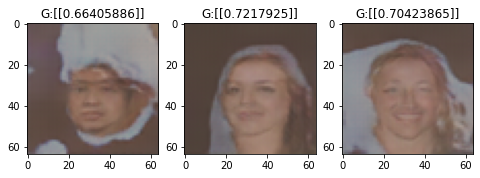

----------
Epoch 362/500
----------
Train Loss: 
G Loss : 0.7217
D Loss : 0.9445
----------
Epoch 363/500
----------
Train Loss: 
G Loss : 0.7089
D Loss : 0.9404
Model saved!


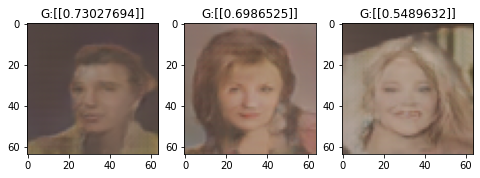

----------
Epoch 364/500
----------
Train Loss: 
G Loss : 0.7171
D Loss : 0.9353
----------
Epoch 365/500
----------
Train Loss: 
G Loss : 0.7189
D Loss : 0.9373
Model saved!


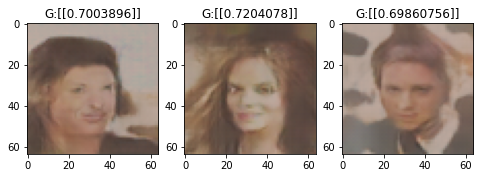

----------
Epoch 366/500
----------
Train Loss: 
G Loss : 0.7083
D Loss : 0.9450
----------
Epoch 367/500
----------
Train Loss: 
G Loss : 0.7127
D Loss : 0.9359
Model saved!


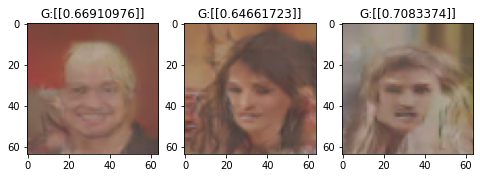

----------
Epoch 368/500
----------
Train Loss: 
G Loss : 0.7153
D Loss : 0.9443
----------
Epoch 369/500
----------
Train Loss: 
G Loss : 0.7148
D Loss : 0.9366
Model saved!


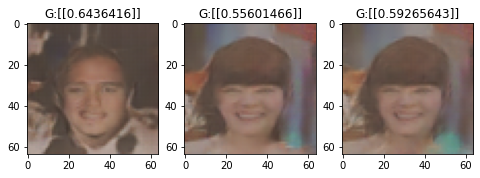

----------
Epoch 370/500
----------
Train Loss: 
G Loss : 0.7127
D Loss : 0.9366
----------
Epoch 371/500
----------
Train Loss: 
G Loss : 0.7137
D Loss : 0.9379
Model saved!


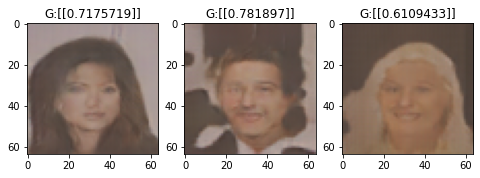

----------
Epoch 372/500
----------
Train Loss: 
G Loss : 0.7108
D Loss : 0.9432
----------
Epoch 373/500
----------
Train Loss: 
G Loss : 0.7167
D Loss : 0.9353
Model saved!


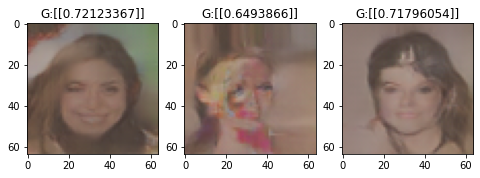

----------
Epoch 374/500
----------
Train Loss: 
G Loss : 0.7180
D Loss : 0.9296
----------
Epoch 375/500
----------
Train Loss: 
G Loss : 0.7154
D Loss : 0.9344
Model saved!


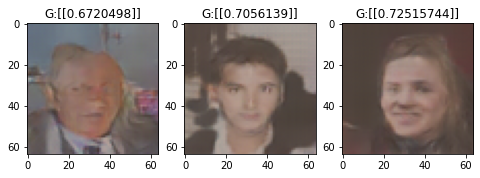

----------
Epoch 376/500
----------
Train Loss: 
G Loss : 0.7121
D Loss : 0.9422
----------
Epoch 377/500
----------
Train Loss: 
G Loss : 0.7169
D Loss : 0.9388
Model saved!


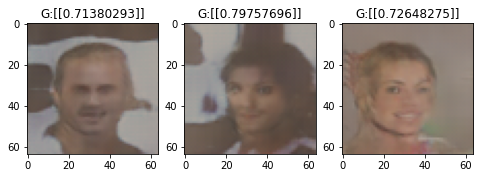

----------
Epoch 378/500
----------
Train Loss: 
G Loss : 0.7155
D Loss : 0.9267
----------
Epoch 379/500
----------
Train Loss: 
G Loss : 0.7171
D Loss : 0.9290
Model saved!


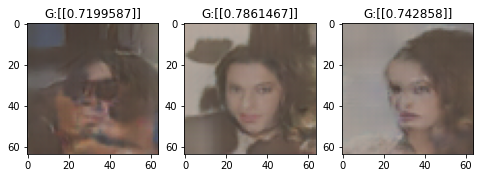

----------
Epoch 380/500
----------
Train Loss: 
G Loss : 0.7173
D Loss : 0.9309
----------
Epoch 381/500
----------
Train Loss: 
G Loss : 0.7163
D Loss : 0.9391
Model saved!


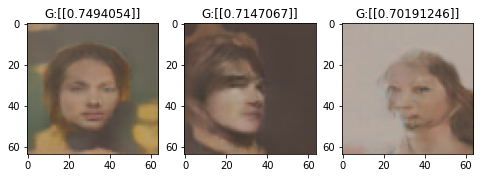

----------
Epoch 382/500
----------
Train Loss: 
G Loss : 0.7146
D Loss : 0.9351
----------
Epoch 383/500
----------
Train Loss: 
G Loss : 0.7146
D Loss : 0.9431
Model saved!


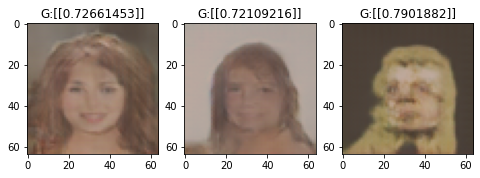

----------
Epoch 384/500
----------
Train Loss: 
G Loss : 0.7167
D Loss : 0.9322
----------
Epoch 385/500
----------
Train Loss: 
G Loss : 0.7097
D Loss : 0.9399
Model saved!


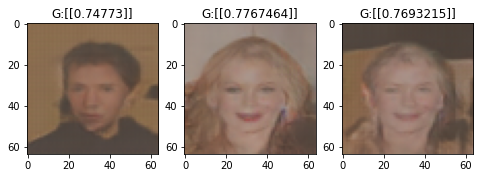

----------
Epoch 386/500
----------
Train Loss: 
G Loss : 0.7147
D Loss : 0.9309
----------
Epoch 387/500
----------
Train Loss: 
G Loss : 0.7176
D Loss : 0.9326
Model saved!


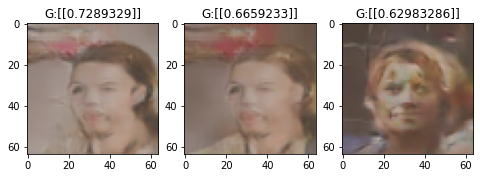

----------
Epoch 388/500
----------
Train Loss: 
G Loss : 0.7133
D Loss : 0.9283
----------
Epoch 389/500
----------
Train Loss: 
G Loss : 0.7182
D Loss : 0.9329
Model saved!


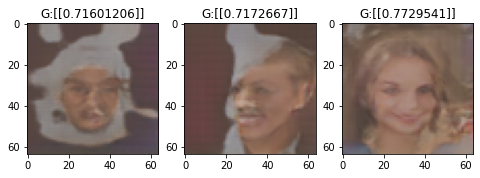

----------
Epoch 390/500
----------
Train Loss: 
G Loss : 0.7160
D Loss : 0.9304
----------
Epoch 391/500
----------
Train Loss: 
G Loss : 0.7189
D Loss : 0.9365
Model saved!


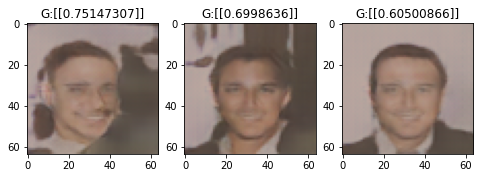

----------
Epoch 392/500
----------
Train Loss: 
G Loss : 0.7158
D Loss : 0.9282
----------
Epoch 393/500
----------
Train Loss: 
G Loss : 0.7184
D Loss : 0.9342
Model saved!


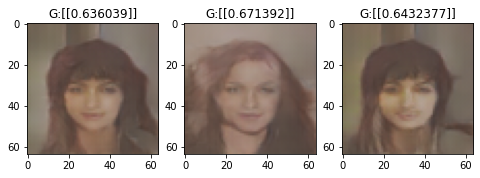

----------
Epoch 394/500
----------
Train Loss: 
G Loss : 0.7180
D Loss : 0.9256
----------
Epoch 395/500
----------
Train Loss: 
G Loss : 0.7186
D Loss : 0.9235
Model saved!


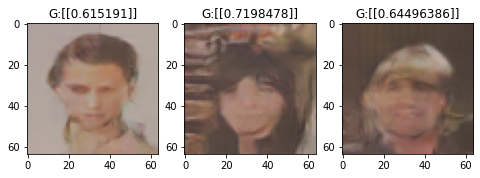

----------
Epoch 396/500
----------
Train Loss: 
G Loss : 0.7208
D Loss : 0.9347
----------
Epoch 397/500
----------
Train Loss: 
G Loss : 0.7166
D Loss : 0.9231
Model saved!


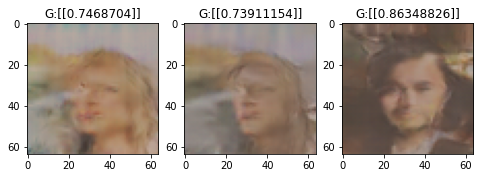

----------
Epoch 398/500
----------
Train Loss: 
G Loss : 0.7247
D Loss : 0.9179
----------
Epoch 399/500
----------
Train Loss: 
G Loss : 0.7219
D Loss : 0.9292
Model saved!


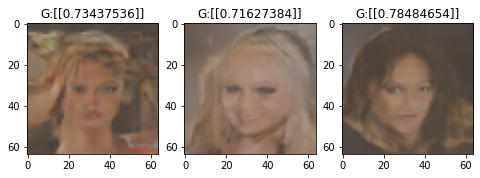

----------
Epoch 400/500
----------
Train Loss: 
G Loss : 0.7184
D Loss : 0.9283
----------
Epoch 401/500
----------
Train Loss: 
G Loss : 0.7244
D Loss : 0.9231
Model saved!


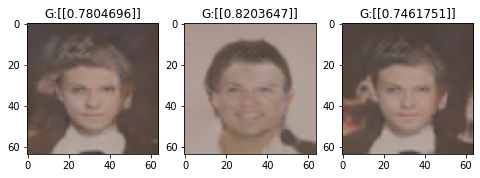

----------
Epoch 402/500
----------
Train Loss: 
G Loss : 0.7140
D Loss : 0.9389
----------
Epoch 403/500
----------
Train Loss: 
G Loss : 0.7129
D Loss : 0.9359
Model saved!


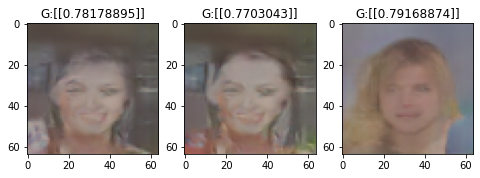

----------
Epoch 404/500
----------
Train Loss: 
G Loss : 0.7138
D Loss : 0.9346
----------
Epoch 405/500
----------
Train Loss: 
G Loss : 0.7189
D Loss : 0.9220
Model saved!


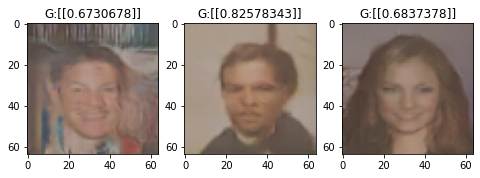

----------
Epoch 406/500
----------
Train Loss: 
G Loss : 0.7197
D Loss : 0.9272
----------
Epoch 407/500
----------
Train Loss: 
G Loss : 0.7203
D Loss : 0.9202
Model saved!


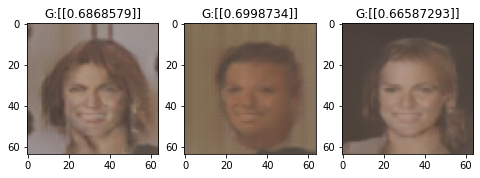

----------
Epoch 408/500
----------
Train Loss: 
G Loss : 0.7281
D Loss : 0.9248
----------
Epoch 409/500
----------
Train Loss: 
G Loss : 0.7156
D Loss : 0.9337
Model saved!


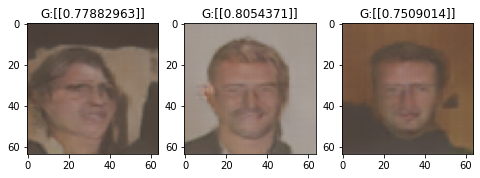

----------
Epoch 410/500
----------
Train Loss: 
G Loss : 0.7221
D Loss : 0.9267
----------
Epoch 411/500
----------
Train Loss: 
G Loss : 0.7171
D Loss : 0.9241
Model saved!


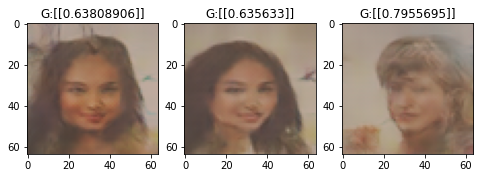

----------
Epoch 412/500
----------
Train Loss: 
G Loss : 0.7158
D Loss : 0.9268
----------
Epoch 413/500
----------
Train Loss: 
G Loss : 0.7168
D Loss : 0.9271
Model saved!


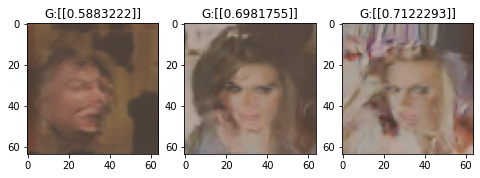

----------
Epoch 414/500
----------
Train Loss: 
G Loss : 0.7182
D Loss : 0.9248
----------
Epoch 415/500
----------
Train Loss: 
G Loss : 0.7263
D Loss : 0.9245
Model saved!


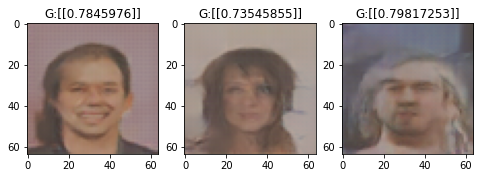

----------
Epoch 416/500
----------
Train Loss: 
G Loss : 0.7227
D Loss : 0.9228
----------
Epoch 417/500
----------
Train Loss: 
G Loss : 0.7179
D Loss : 0.9260
Model saved!


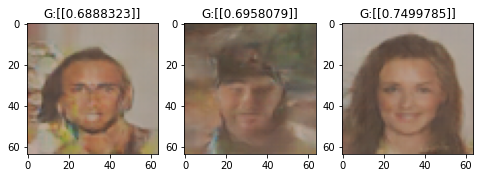

----------
Epoch 418/500
----------
Train Loss: 
G Loss : 0.7158
D Loss : 0.9252
----------
Epoch 419/500
----------
Train Loss: 
G Loss : 0.7209
D Loss : 0.9230
Model saved!


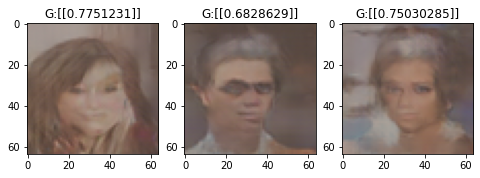

----------
Epoch 420/500
----------
Train Loss: 
G Loss : 0.7160
D Loss : 0.9236
----------
Epoch 421/500
----------
Train Loss: 
G Loss : 0.7168
D Loss : 0.9310
Model saved!


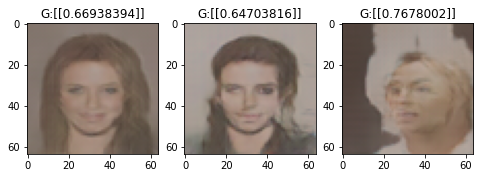

----------
Epoch 422/500
----------
Train Loss: 
G Loss : 0.7232
D Loss : 0.9140
----------
Epoch 423/500
----------
Train Loss: 
G Loss : 0.7202
D Loss : 0.9203
Model saved!


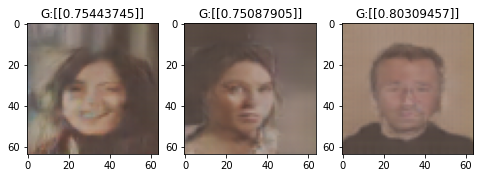

----------
Epoch 424/500
----------
Train Loss: 
G Loss : 0.7201
D Loss : 0.9260
----------
Epoch 425/500
----------
Train Loss: 
G Loss : 0.7259
D Loss : 0.9171
Model saved!


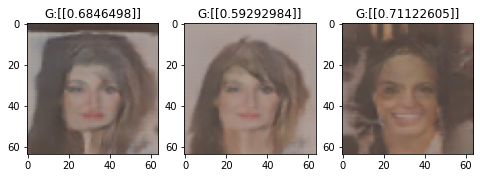

----------
Epoch 426/500
----------
Train Loss: 
G Loss : 0.7252
D Loss : 0.9226
----------
Epoch 427/500
----------
Train Loss: 
G Loss : 0.7207
D Loss : 0.9167
Model saved!


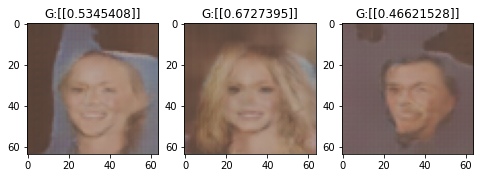

----------
Epoch 428/500
----------
Train Loss: 
G Loss : 0.7275
D Loss : 0.9186
----------
Epoch 429/500
----------
Train Loss: 
G Loss : 0.7224
D Loss : 0.9255
Model saved!


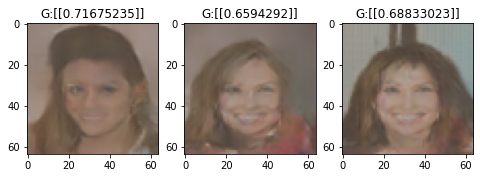

----------
Epoch 430/500
----------
Train Loss: 
G Loss : 0.7155
D Loss : 0.9191
----------
Epoch 431/500
----------
Train Loss: 
G Loss : 0.7235
D Loss : 0.9169
Model saved!


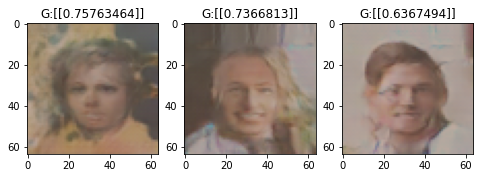

----------
Epoch 432/500
----------
Train Loss: 
G Loss : 0.7277
D Loss : 0.9094
----------
Epoch 433/500
----------
Train Loss: 
G Loss : 0.7281
D Loss : 0.9125
Model saved!


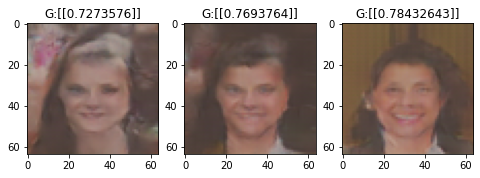

----------
Epoch 434/500
----------
Train Loss: 
G Loss : 0.7239
D Loss : 0.9174
----------
Epoch 435/500
----------
Train Loss: 
G Loss : 0.7221
D Loss : 0.9201
Model saved!


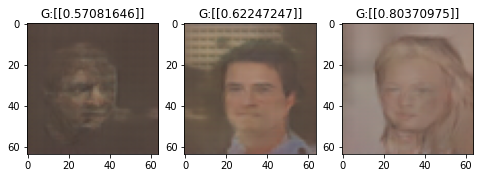

----------
Epoch 436/500
----------
Train Loss: 
G Loss : 0.7257
D Loss : 0.9109
----------
Epoch 437/500
----------
Train Loss: 
G Loss : 0.7200
D Loss : 0.9126
Model saved!


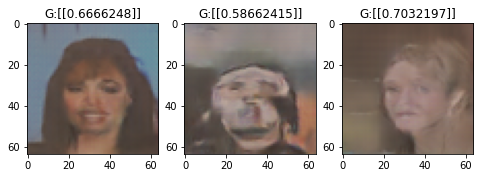

----------
Epoch 438/500
----------
Train Loss: 
G Loss : 0.7252
D Loss : 0.9208
----------
Epoch 439/500
----------
Train Loss: 
G Loss : 0.7236
D Loss : 0.9103
Model saved!


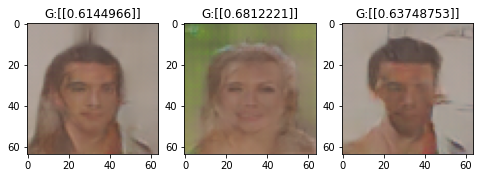

----------
Epoch 440/500
----------
Train Loss: 
G Loss : 0.7187
D Loss : 0.9245
----------
Epoch 441/500
----------
Train Loss: 
G Loss : 0.7241
D Loss : 0.9141
Model saved!


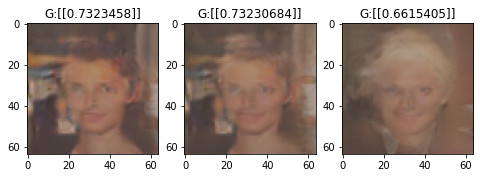

----------
Epoch 442/500
----------
Train Loss: 
G Loss : 0.7267
D Loss : 0.9118
----------
Epoch 443/500
----------
Train Loss: 
G Loss : 0.7202
D Loss : 0.9152
Model saved!


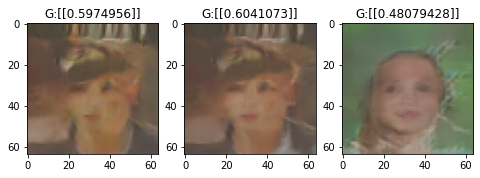

----------
Epoch 444/500
----------
Train Loss: 
G Loss : 0.7282
D Loss : 0.9165
----------
Epoch 445/500
----------
Train Loss: 
G Loss : 0.7181
D Loss : 0.9253
Model saved!


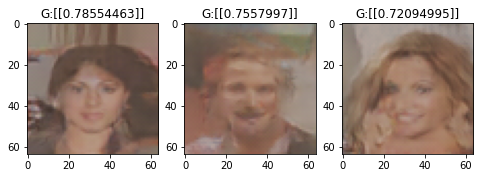

----------
Epoch 446/500
----------
Train Loss: 
G Loss : 0.7140
D Loss : 0.9204
----------
Epoch 447/500
----------
Train Loss: 
G Loss : 0.7238
D Loss : 0.9096
Model saved!


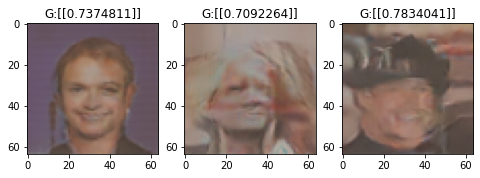

----------
Epoch 448/500
----------
Train Loss: 
G Loss : 0.7255
D Loss : 0.9182
----------
Epoch 449/500
----------
Train Loss: 
G Loss : 0.7229
D Loss : 0.9117
Model saved!


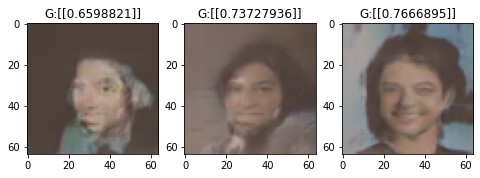

----------
Epoch 450/500
----------
Train Loss: 
G Loss : 0.7211
D Loss : 0.9160
----------
Epoch 451/500
----------
Train Loss: 
G Loss : 0.7267
D Loss : 0.9169
Model saved!


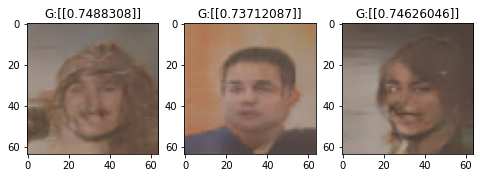

----------
Epoch 452/500
----------
Train Loss: 
G Loss : 0.7206
D Loss : 0.9185
----------
Epoch 453/500
----------
Train Loss: 
G Loss : 0.7216
D Loss : 0.9112
Model saved!


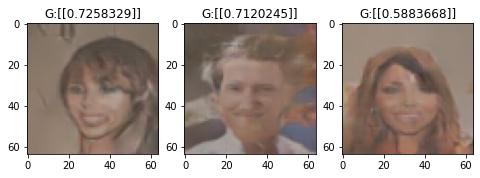

----------
Epoch 454/500
----------
Train Loss: 
G Loss : 0.7255
D Loss : 0.9112
----------
Epoch 455/500
----------
Train Loss: 
G Loss : 0.7262
D Loss : 0.9181
Model saved!


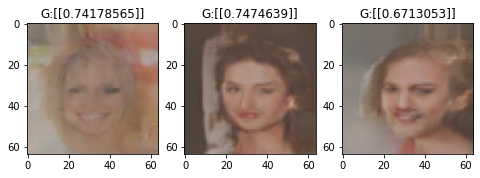

----------
Epoch 456/500
----------
Train Loss: 
G Loss : 0.7187
D Loss : 0.9065
----------
Epoch 457/500
----------
Train Loss: 
G Loss : 0.7296
D Loss : 0.9089
Model saved!


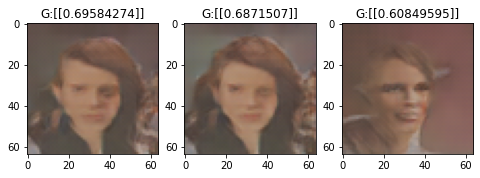

----------
Epoch 458/500
----------
Train Loss: 
G Loss : 0.7282
D Loss : 0.9049
----------
Epoch 459/500
----------
Train Loss: 
G Loss : 0.7283
D Loss : 0.9017
Model saved!


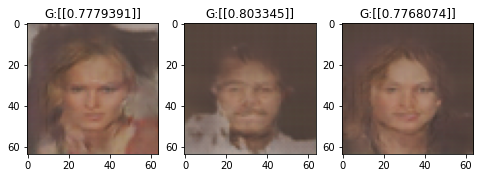

----------
Epoch 460/500
----------
Train Loss: 
G Loss : 0.7266
D Loss : 0.9166
----------
Epoch 461/500
----------
Train Loss: 
G Loss : 0.7248
D Loss : 0.9140
Model saved!


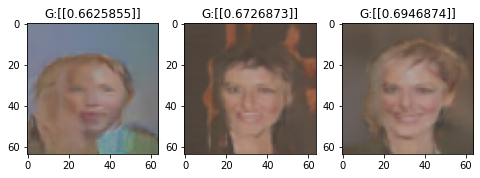

----------
Epoch 462/500
----------
Train Loss: 
G Loss : 0.7264
D Loss : 0.9067
----------
Epoch 463/500
----------
Train Loss: 
G Loss : 0.7290
D Loss : 0.9042
Model saved!


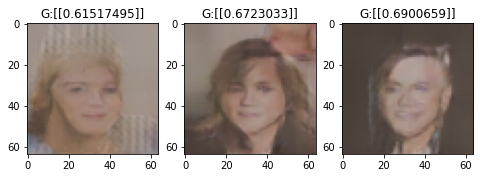

----------
Epoch 464/500
----------
Train Loss: 
G Loss : 0.7270
D Loss : 0.9037
----------
Epoch 465/500
----------
Train Loss: 
G Loss : 0.7196
D Loss : 0.9149
Model saved!


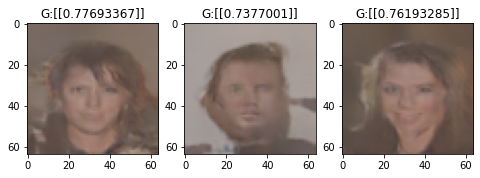

----------
Epoch 466/500
----------
Train Loss: 
G Loss : 0.7197
D Loss : 0.9269
----------
Epoch 467/500
----------
Train Loss: 
G Loss : 0.7234
D Loss : 0.9164
Model saved!


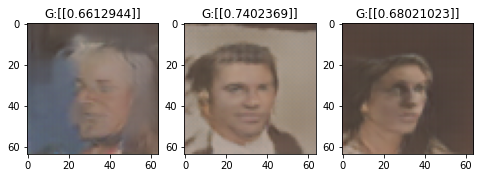

----------
Epoch 468/500
----------
Train Loss: 
G Loss : 0.7219
D Loss : 0.9186
----------
Epoch 469/500
----------
Train Loss: 
G Loss : 0.7259
D Loss : 0.9065
Model saved!


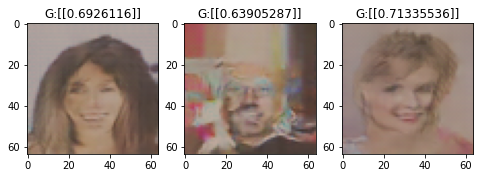

----------
Epoch 470/500
----------
Train Loss: 
G Loss : 0.7243
D Loss : 0.9180
----------
Epoch 471/500
----------
Train Loss: 
G Loss : 0.7249
D Loss : 0.9126
Model saved!


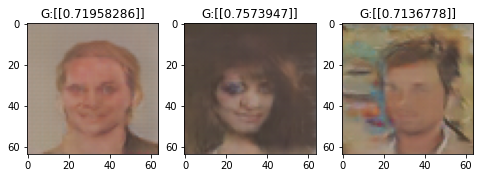

----------
Epoch 472/500
----------
Train Loss: 
G Loss : 0.7222
D Loss : 0.9143
----------
Epoch 473/500
----------
Train Loss: 
G Loss : 0.7227
D Loss : 0.9151
Model saved!


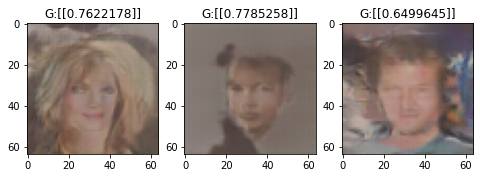

----------
Epoch 474/500
----------
Train Loss: 
G Loss : 0.7214
D Loss : 0.9160
----------
Epoch 475/500
----------
Train Loss: 
G Loss : 0.7229
D Loss : 0.9194
Model saved!


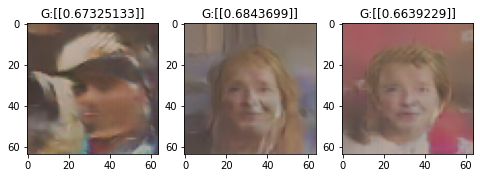

----------
Epoch 476/500
----------
Train Loss: 
G Loss : 0.7195
D Loss : 0.9142
----------
Epoch 477/500
----------
Train Loss: 
G Loss : 0.7232
D Loss : 0.9253
Model saved!


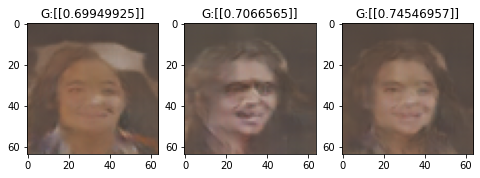

----------
Epoch 478/500
----------
Train Loss: 
G Loss : 0.7252
D Loss : 0.9088
----------
Epoch 479/500
----------
Train Loss: 
G Loss : 0.7187
D Loss : 0.9136
Model saved!


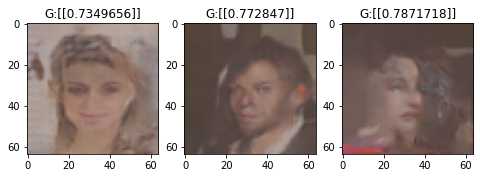

----------
Epoch 480/500
----------
Train Loss: 
G Loss : 0.7263
D Loss : 0.9065
----------
Epoch 481/500
----------
Train Loss: 
G Loss : 0.7207
D Loss : 0.9188
Model saved!


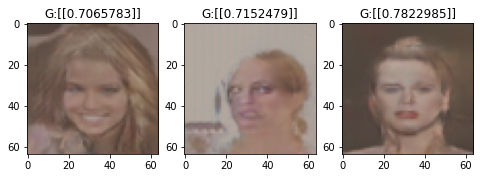

----------
Epoch 482/500
----------
Train Loss: 
G Loss : 0.7177
D Loss : 0.9190
----------
Epoch 483/500
----------
Train Loss: 
G Loss : 0.7233
D Loss : 0.9101
Model saved!


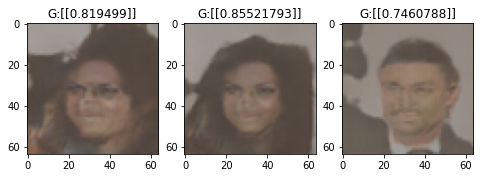

----------
Epoch 484/500
----------
Train Loss: 
G Loss : 0.7211
D Loss : 0.9126
----------
Epoch 485/500
----------
Train Loss: 
G Loss : 0.7221
D Loss : 0.9139
Model saved!


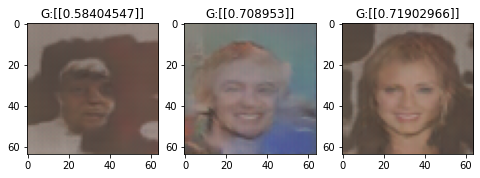

----------
Epoch 486/500
----------
Train Loss: 
G Loss : 0.7230
D Loss : 0.9186
----------
Epoch 487/500
----------
Train Loss: 
G Loss : 0.7209
D Loss : 0.9132
Model saved!


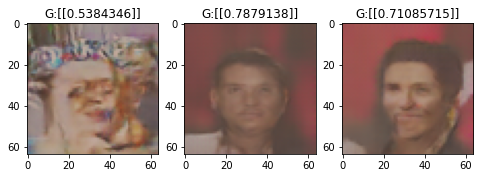

----------
Epoch 488/500
----------
Train Loss: 
G Loss : 0.7236
D Loss : 0.9099
----------
Epoch 489/500
----------
Train Loss: 
G Loss : 0.7294
D Loss : 0.9177
Model saved!


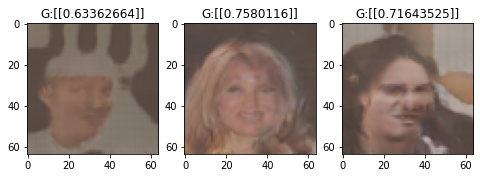

----------
Epoch 490/500
----------
Train Loss: 
G Loss : 0.7170
D Loss : 0.9139
----------
Epoch 491/500
----------
Train Loss: 
G Loss : 0.7226
D Loss : 0.9170
Model saved!


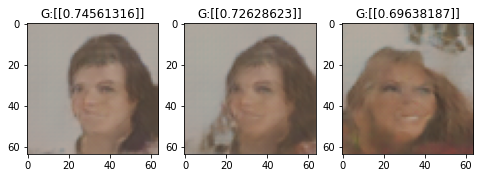

----------
Epoch 492/500
----------
Train Loss: 
G Loss : 0.7233
D Loss : 0.9083
----------
Epoch 493/500
----------
Train Loss: 
G Loss : 0.7265
D Loss : 0.9133
Model saved!


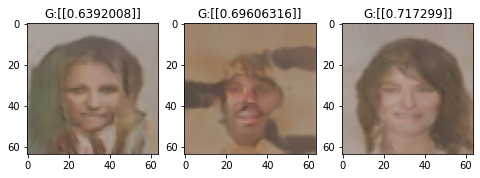

----------
Epoch 494/500
----------
Train Loss: 
G Loss : 0.7248
D Loss : 0.9136
----------
Epoch 495/500
----------
Train Loss: 
G Loss : 0.7156
D Loss : 0.9136
Model saved!


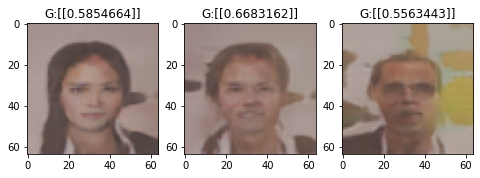

----------
Epoch 496/500
----------
Train Loss: 
G Loss : 0.7239
D Loss : 0.9130
----------
Epoch 497/500
----------
Train Loss: 
G Loss : 0.7259
D Loss : 0.9200
Model saved!


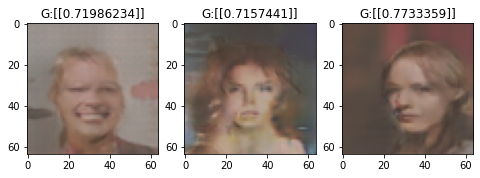

----------
Epoch 498/500
----------
Train Loss: 
G Loss : 0.7258
D Loss : 0.9152
----------
Epoch 499/500
----------
Train Loss: 
G Loss : 0.7214
D Loss : 0.9079
Model saved!


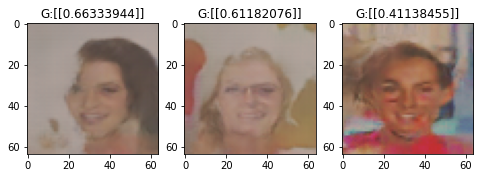

----------
Epoch 500/500
----------
Train Loss: 
G Loss : 0.7238
D Loss : 0.9045
Training complete in 187m 19s


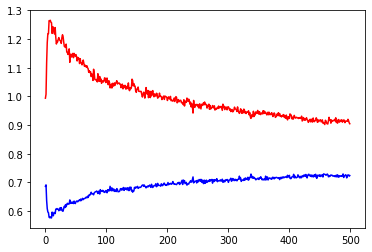

In [12]:
g_loss_recorder = []
d_loss_recorder = []

since = time.time()

for i in range(epochs):
    Gmodel.train()
    Dmodel.train()

    print('-' * 10)
    print('Epoch {}/{}'.format(i+1, epochs))
    print('-' * 10)

    g_loss_epoch = 0.0
    d_loss_epoch = 0.0

    for image in real_image:
        image = image.to(device)
        t_label = torch.tensor(np.random.rand(batchsize, 1) * 0.1 + 0.9, dtype=torch.float).to(device)
        f_label = torch.tensor(np.random.rand(batchsize, 1) * 0.1, dtype=torch.float).to(device)
        noise = torch.randn([batchsize, ch_in, 1, 1]).to(device)

        # train discriminator
        Doptim.zero_grad()

        d_out_real = Dmodel(image)
        d_loss_real = criterion(d_out_real, t_label)

        g_image = Gmodel(noise)
        f_label = get_fakelebal((batchsize, 1)).to(device)

        d_out_fake = Dmodel(g_image)
        d_loss_fake = criterion(d_out_fake, f_label)

        d_loss = d_loss_real + d_loss_fake
        d_loss.backward(retain_graph=True)


        # train generator
        Goptim.zero_grad()

        g_loss = criterion(d_out_fake, t_label)
        g_loss.backward()
        Doptim.step()
        Goptim.step()

        # running loss
        g_loss_epoch += g_loss.cpu().detach().numpy()
        d_loss_epoch += d_loss.cpu().detach().numpy()

    g_loss_epoch = g_loss_epoch / len(real_image)
    g_loss_recorder.append(g_loss_epoch)
    d_loss_epoch = d_loss_epoch / len(real_image)
    d_loss_recorder.append(d_loss_epoch)

    print("Train Loss: ")
    print("G Loss : {:.4f}".format(g_loss_epoch))
    print("D Loss : {:.4f}".format(d_loss_epoch))

    if i % 2 == 0:
        # save model and test
        torch.save(Gmodel, model_dir+"G"+file_name)
        torch.save(Dmodel, model_dir+"D"+file_name)
        print('Model saved!')

        Gmodel.eval()
        Dmodel.eval()
        with torch.no_grad():
            plt.figure(figsize=(8, 8))
            for test in range(3):
                noise_test = torch.randn((1, ch_in, 1, 1)).to(device)
                image_test = Gmodel(noise_test)
                label_test = Dmodel(image_test)

                image_test = transforms.Normalize(mean=-(train_mean/train_std),std=1/train_std)(image_test)              
                image_show = image_test.cpu().numpy()[0].transpose((1,2,0)).astype(np.float)
                image_show[image_show < 0] = 0.0

                plt.subplot(1, 3, test+1)
                plt.title("G:"+str(label_test.cpu().numpy()[:,:]))
                plt.imshow(image_show)

            plt.show()

time_elapsed = time.time() - since
print('Training complete in {:.0f}m {:.0f}s'.format(
    time_elapsed // 60, time_elapsed % 60))

plt.plot(np.array(d_loss_recorder), 'r')
plt.plot(np.array(g_loss_recorder), 'b')
plt.show()